# Project 2: Social Network Mining

| Name | ID |
|-----------|-----|
| Hsien-Chih Hung | 104466136 |
| Trung Le | 205223834 |
| Radhika Nayar | 805226085 |
| Juan Rebanal | 005227239 |

## Part 1: Facebook Network

In [0]:
library(igraph)
setwd("~/Desktop/ECE232E/project2/")

### Q1-2

[1] TRUE

[1] 8

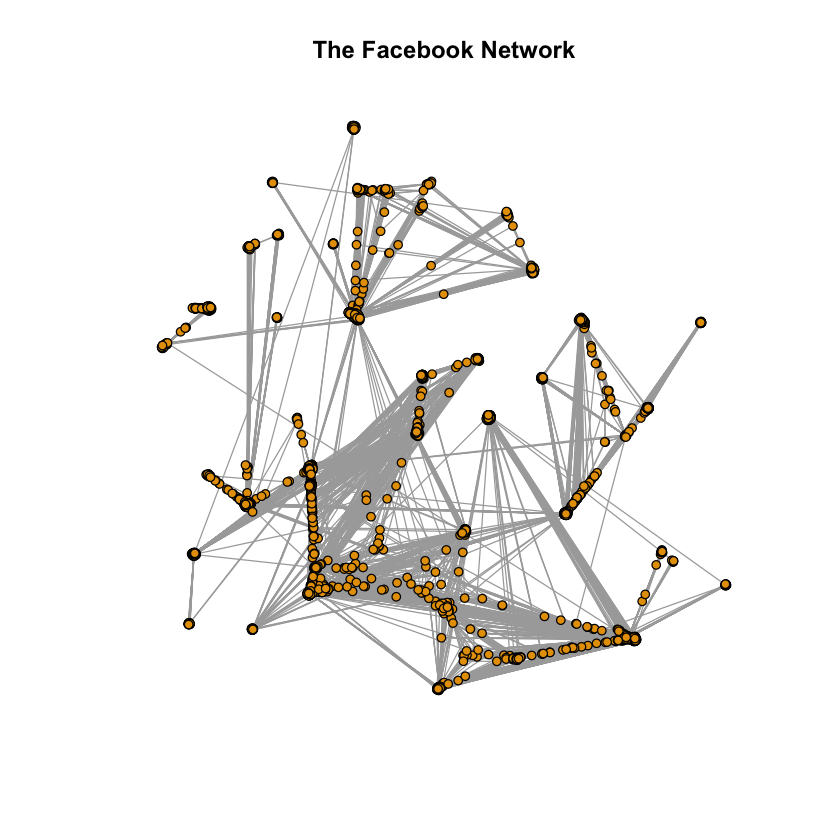

In [0]:
#Question1,2:
fb_read <- read_graph("facebook_combined.txt", directed = FALSE)
fb_el <- as_edgelist(fb_read)
g = graph_from_edgelist(fb_el, directed = FALSE)
plot(g, vertex.size=3,vertex.label=NA, main="The Facebook Network")
is.connected(g)
diameter(g, directed = FALSE)

### Q3

[1] 43.69101

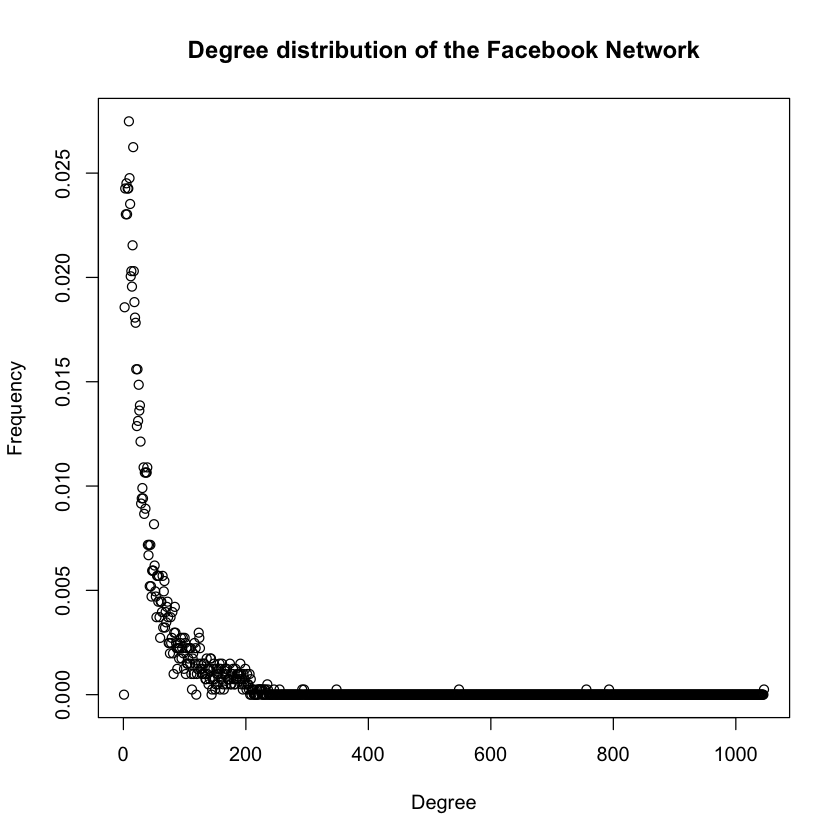

In [0]:
#Question3:
plot(degree.distribution(g),main="Degree distribution of the Facebook Network",
     xlab="Degree",ylab="Frequency")
mean(degree(g))

### Q4

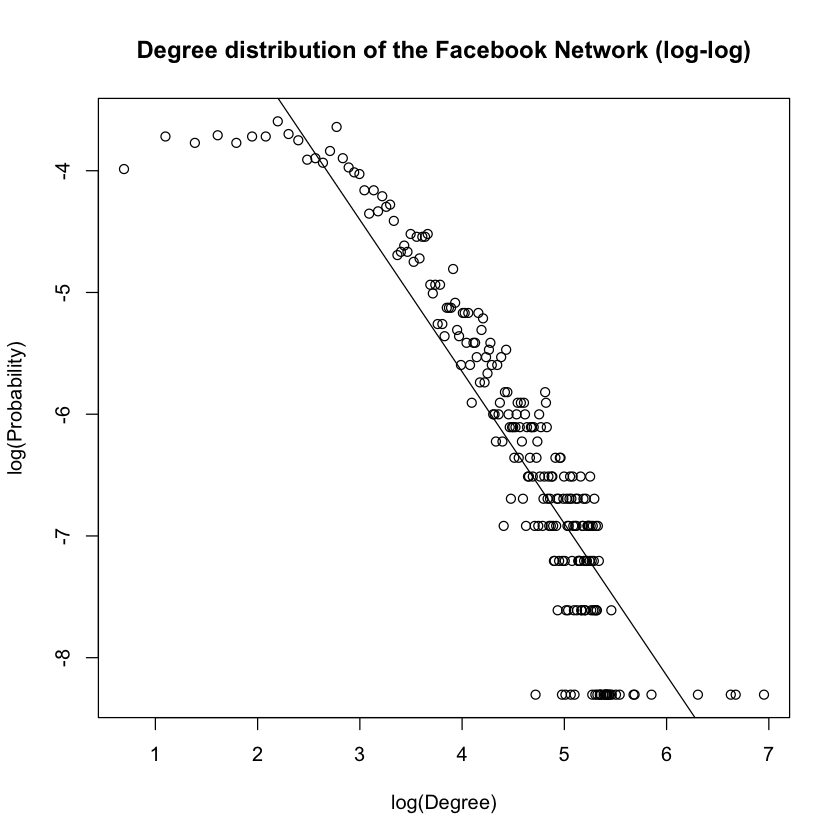

In [0]:
#Question4:
degree_log = log(seq(0:max(degree(g))))
distribution_log = log(degree.distribution(g))

index = !is.infinite(degree_log) & !is.infinite(distribution_log)
degree_log = degree_log[index]
distribution_log = distribution_log[index]

plot(degree_log, distribution_log, 
     main = "Degree distribution of the Facebook Network (log-log)",
     xlab = "log(Degree)", ylab = "log(Probability)") 
abline(lm(distribution_log ~ degree_log))
#print(mod)

### Q5-7

[1] 348

[1] 2866

[1] 2

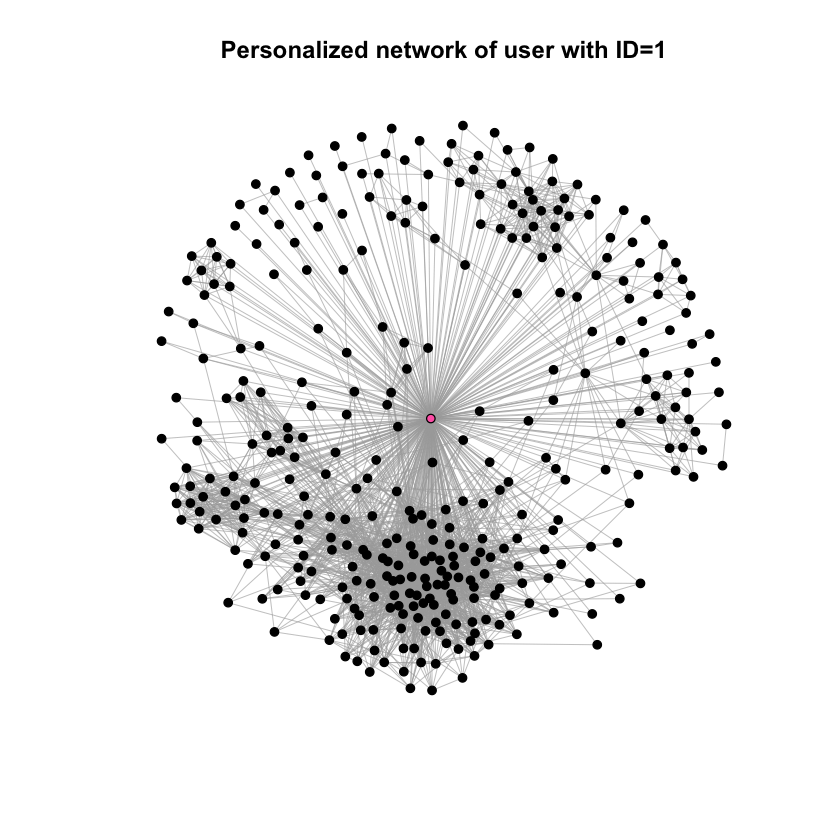

In [0]:
#Question5,6:
g1 <- induced_subgraph(g, c(1, neighbors(g, 1)))
vertex_color <- rep("black", vcount(g1))
vertex_color[1] <- "hotpink"
plot.igraph(g1, vertex.label = NA,
            vertex.size = 3, vertex.color = vertex_color, 
            edge.width=0.5, edge.arrow.size = 0,
            main = "Personalized network of user with ID=1")
vcount(g1) #number of nodes
ecount(g1) #number of edges
diameter(g1)

### Q8

In [0]:
#Question8:
core_number <- which(neighborhood.size(g,1,nodes=V(g))>201)
print(length(core_number)) #number of core nodes
avg_core_deg <- mean(degree(g, v=V(g)[core_number]))
print(avg_core_deg) #average degree of core nodes

[1] 40
[1] 279.375


### Q9

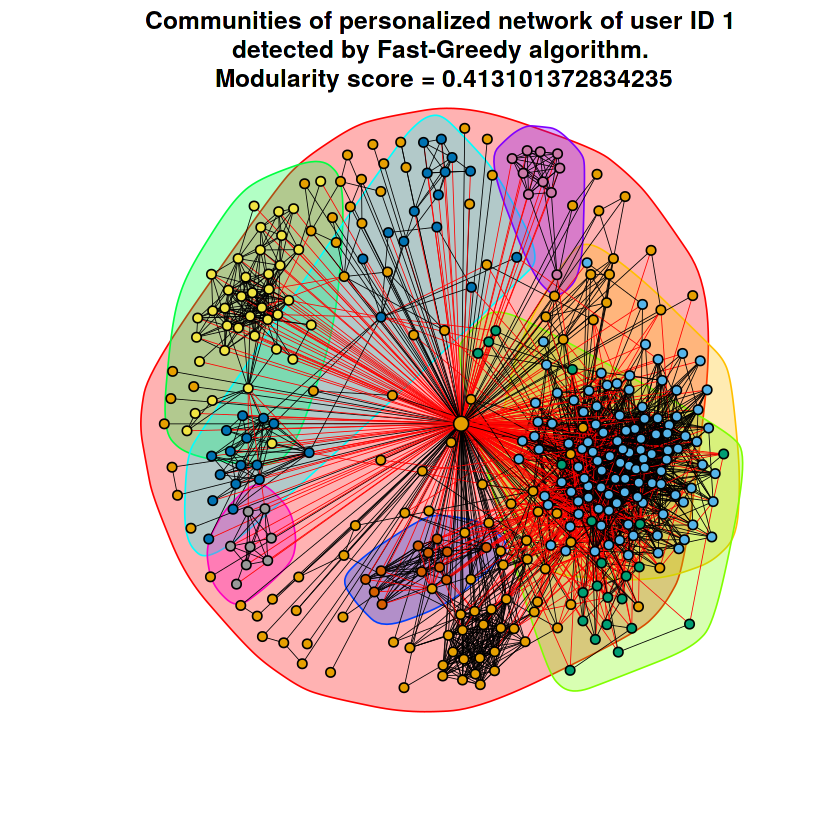

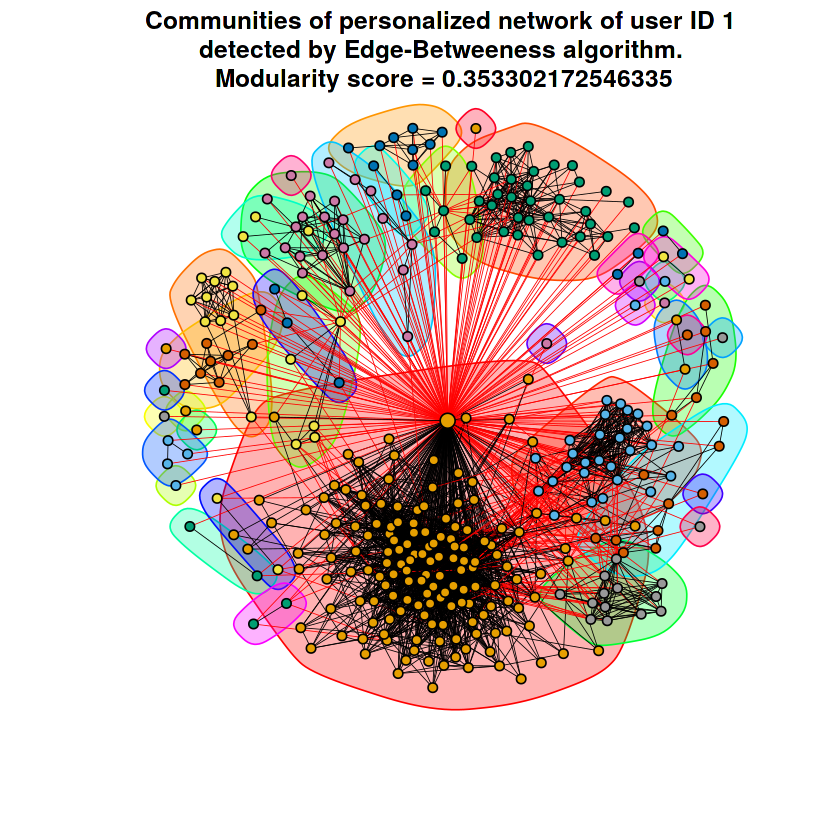

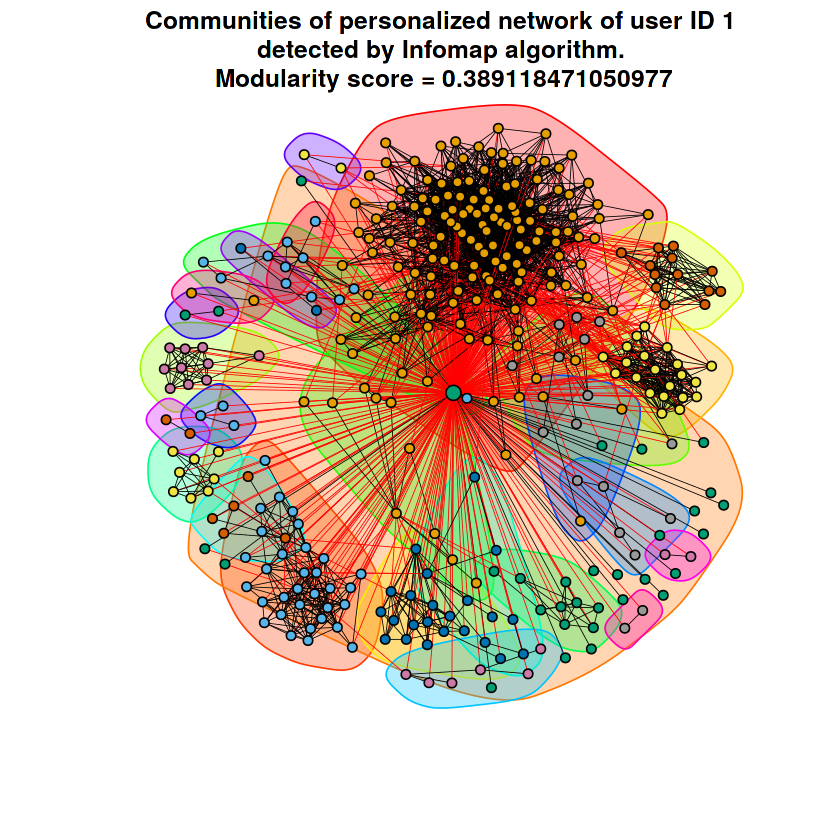

In [0]:
pers_net_comm_detect = function(graph, core_node, include_core_node, algorithm, algorithm_name){
    if (include_core_node==TRUE){
        pers_net = induced_subgraph(graph, c(core_node, neighbors(graph, core_node)))
    }
    else {
        pers_net = induced_subgraph(graph, neighbors(graph, core_node))
    }
    vertex_size = rep(3, vcount(pers_net))
    vertex_size[1] = 5
    comm = algorithm(pers_net)
    modularity_score = modularity(pers_net, membership(comm))
    plot(comm, pers_net,
         vertex.label = NA, vertex.size = vertex_size, edge.width=0.5,
         main = paste("Communities of personalized network of user ID", core_node, 
                      "\ndetected by", algorithm_name, "algorithm.",
                      "\nModularity score =", modularity_score))
}

pers_net_comm_detect(g, core_node=1, include_core_node=TRUE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=1, include_core_node=TRUE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=1, include_core_node=TRUE, cluster_infomap, "Infomap")

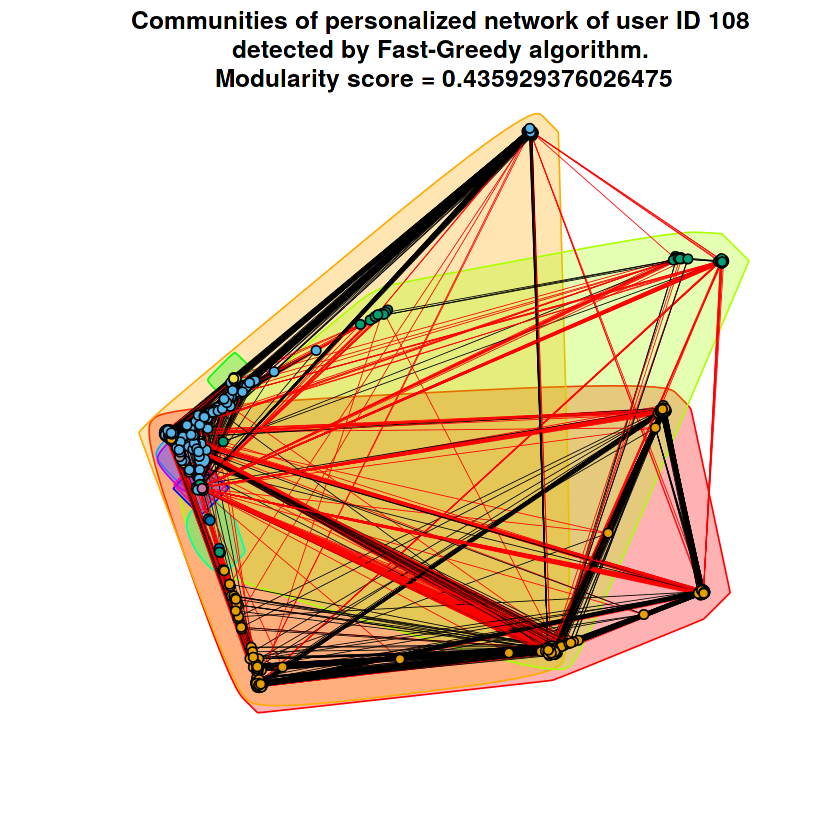

In [0]:
pers_net_comm_detect(g, core_node=108, include_core_node=TRUE, cluster_fast_greedy, "Fast-Greedy")

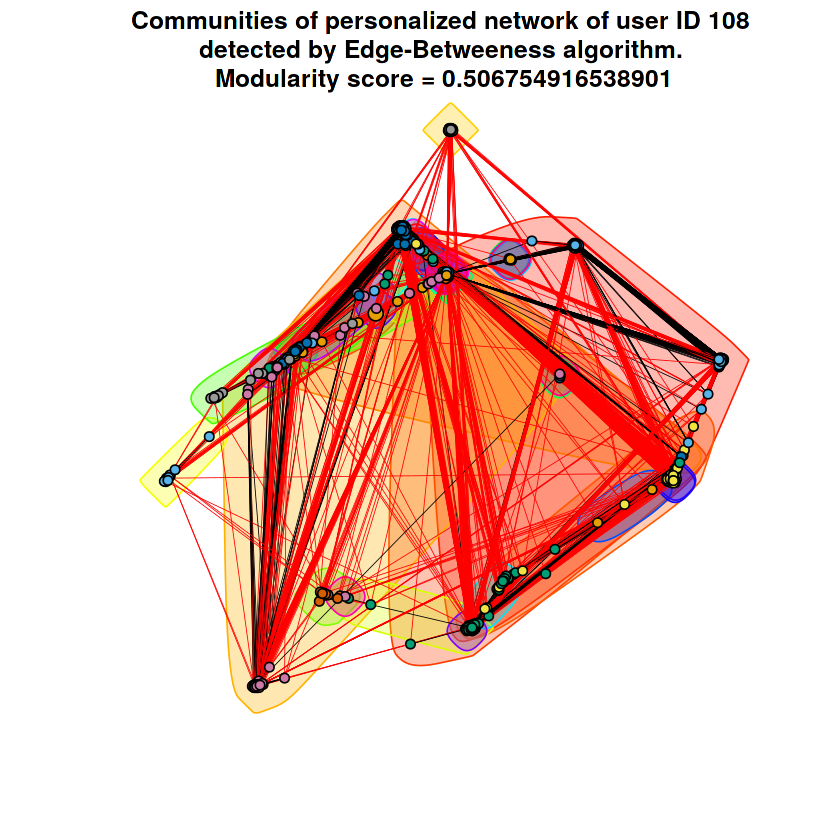

In [0]:
pers_net_comm_detect(g, core_node=108, include_core_node=TRUE, cluster_edge_betweenness, "Edge-Betweeness")

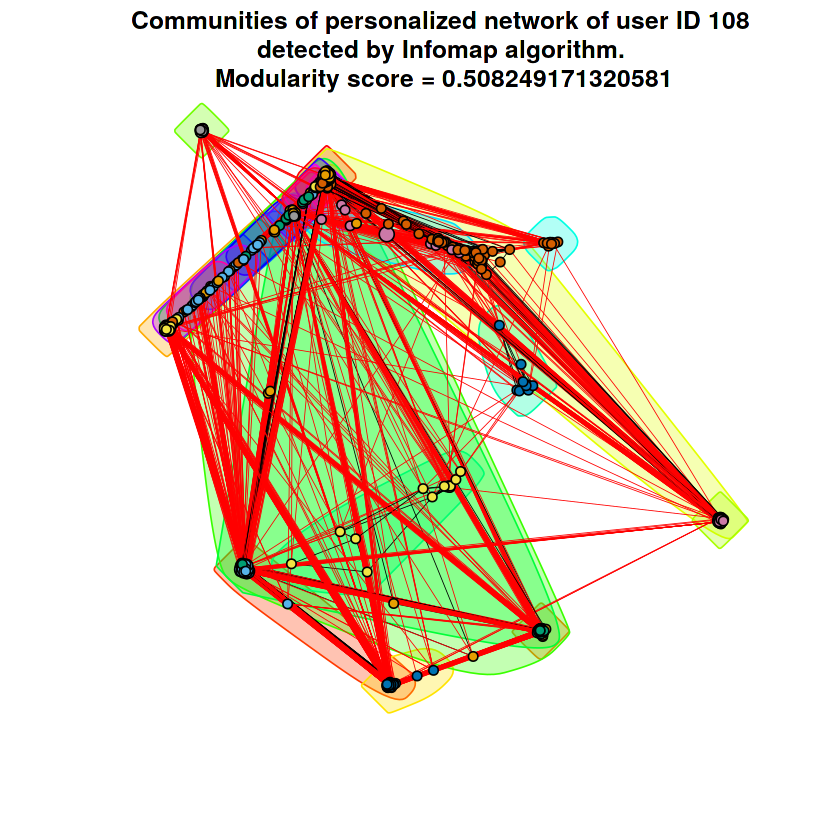

In [0]:
pers_net_comm_detect(g, core_node=108, include_core_node=TRUE, cluster_infomap, "Infomap")

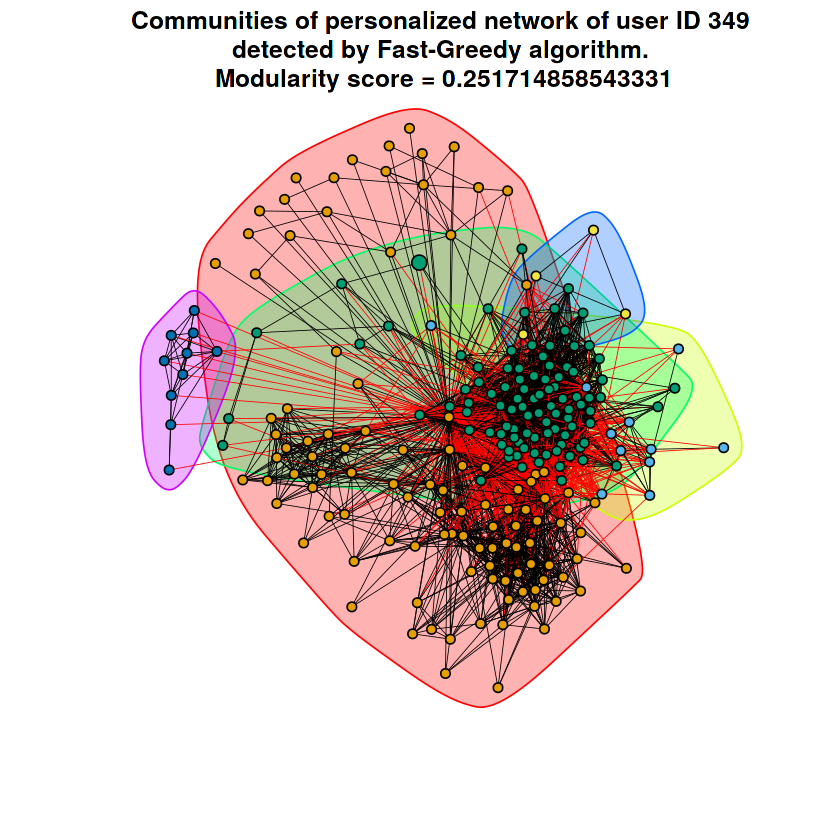

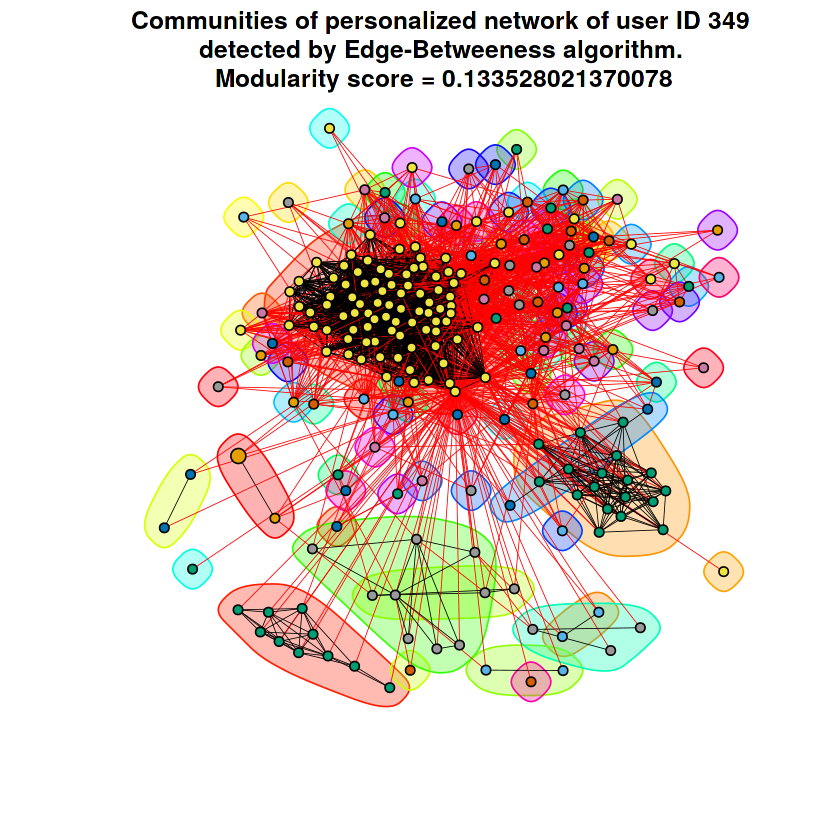

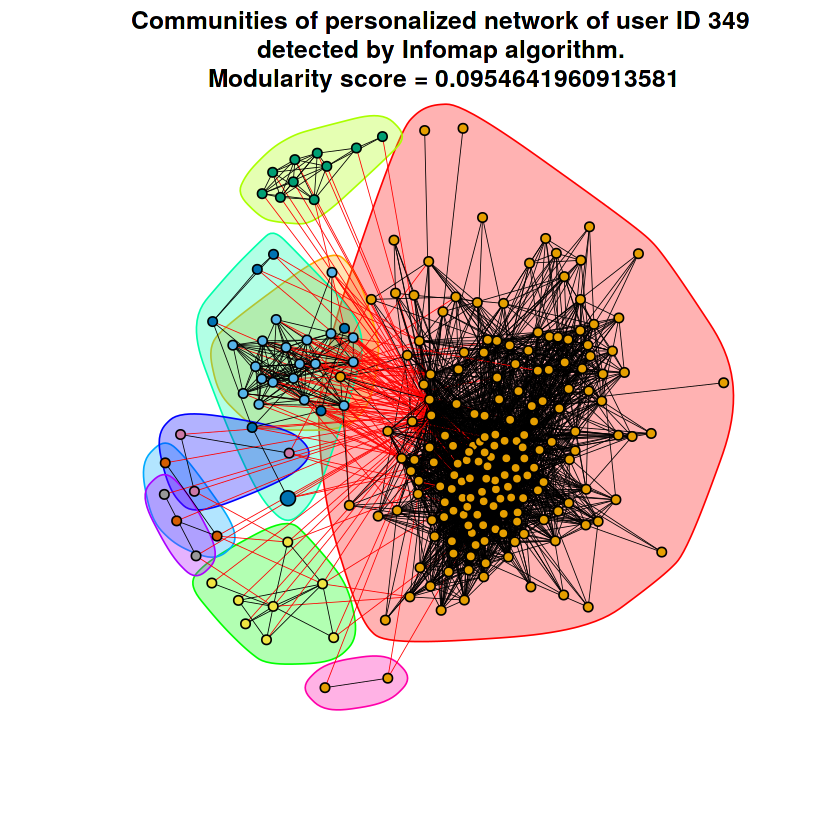

In [0]:
pers_net_comm_detect(g, core_node=349, include_core_node=TRUE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=349, include_core_node=TRUE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=349, include_core_node=TRUE, cluster_infomap, "Infomap")

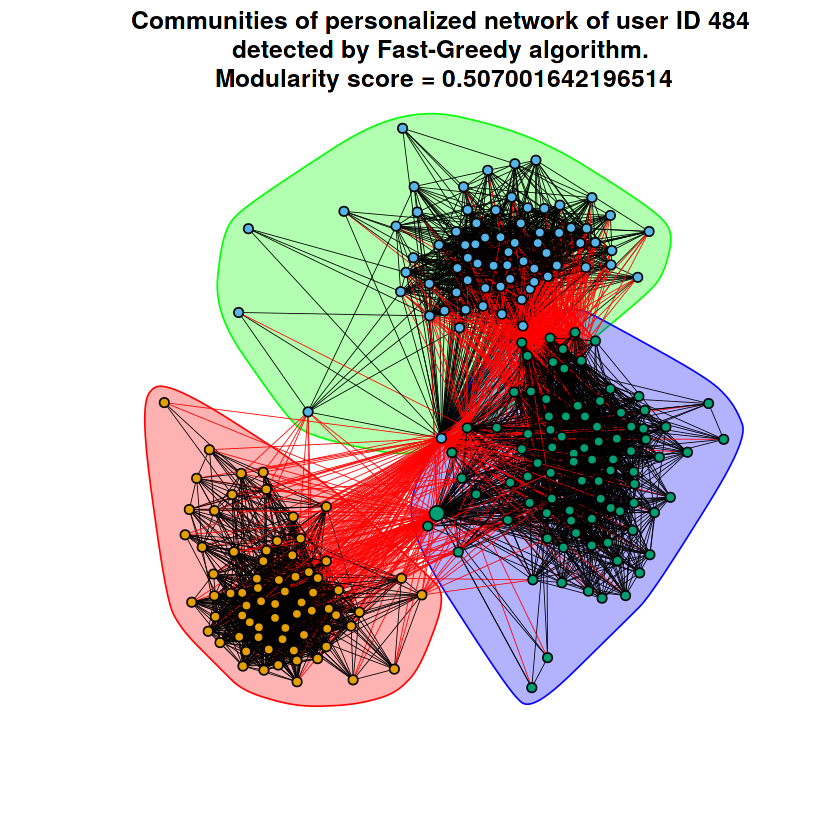

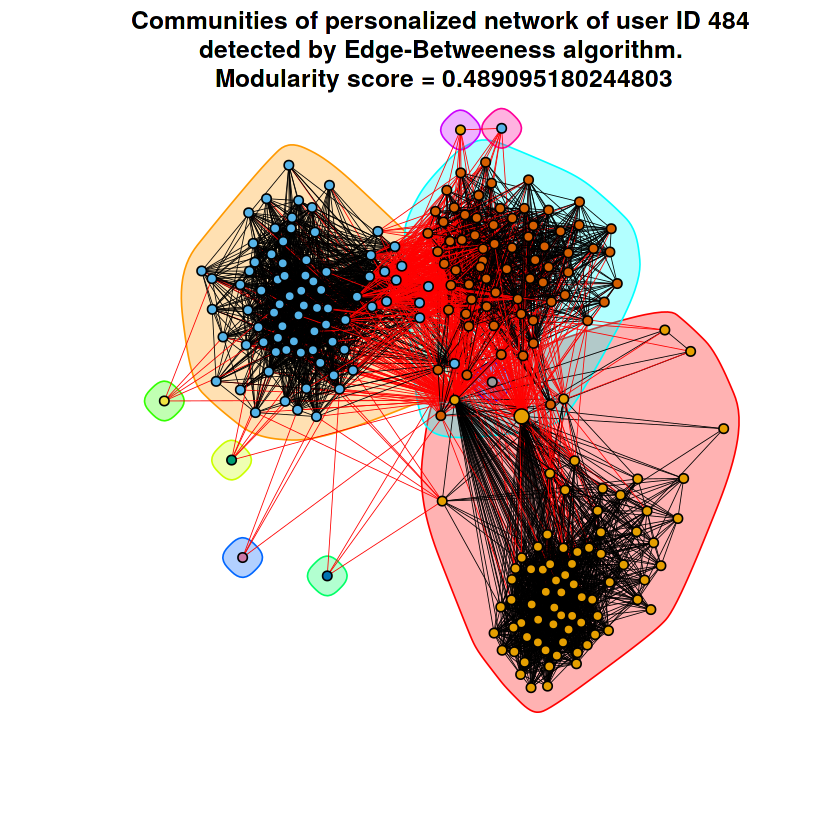

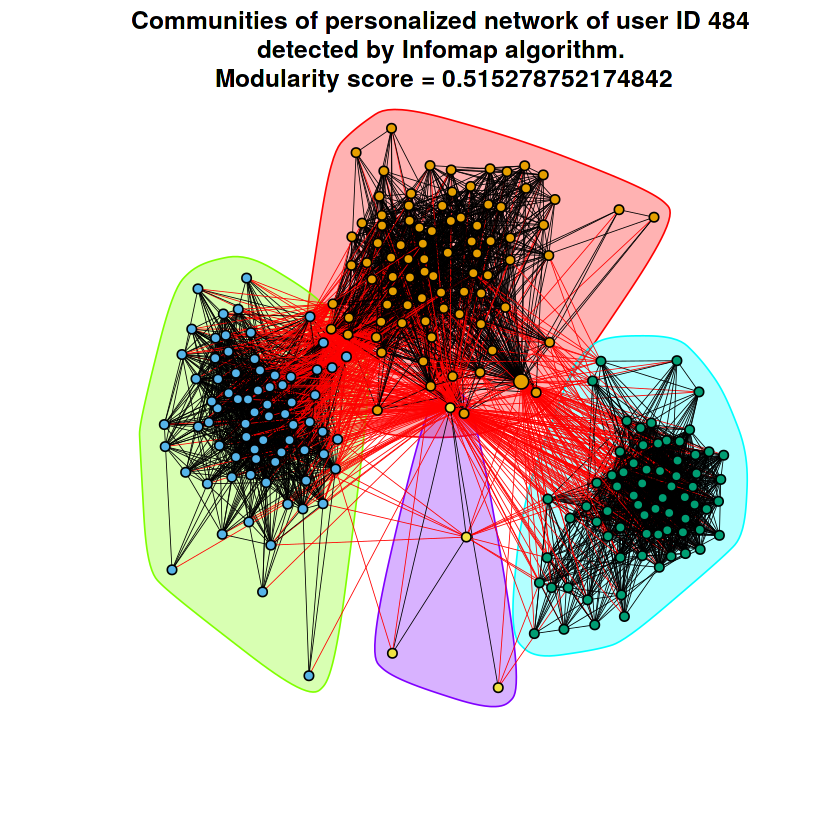

In [0]:
pers_net_comm_detect(g, core_node=484, include_core_node=TRUE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=484, include_core_node=TRUE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=484, include_core_node=TRUE, cluster_infomap, "Infomap")

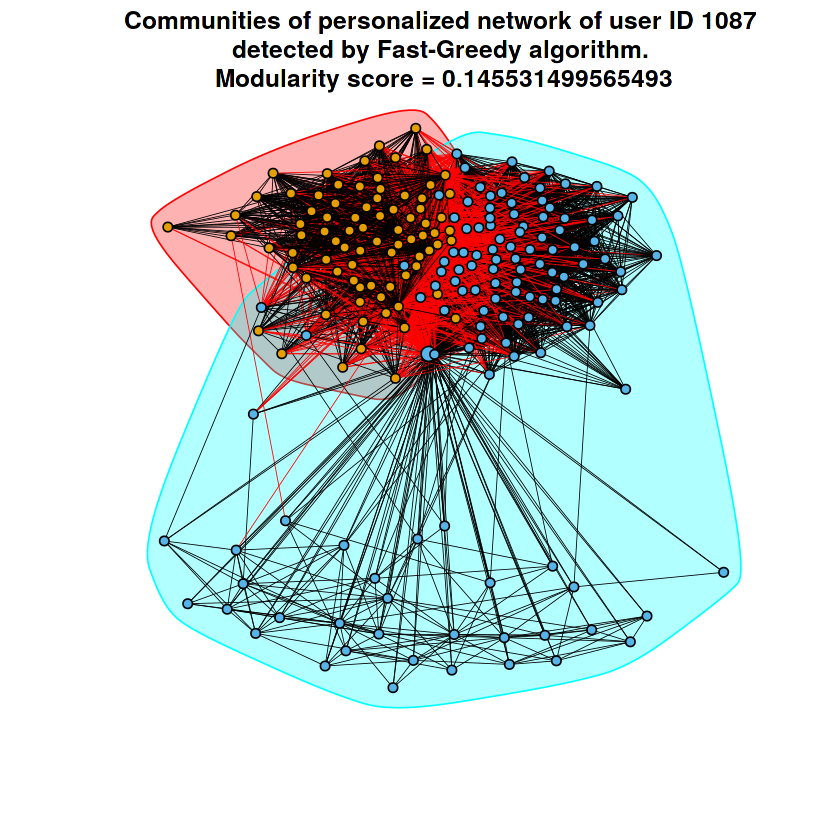

In [0]:
pers_net_comm_detect(g, core_node=1087, include_core_node=TRUE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=1087, include_core_node=TRUE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=1087, include_core_node=TRUE, cluster_infomap, "Infomap")

### Q10

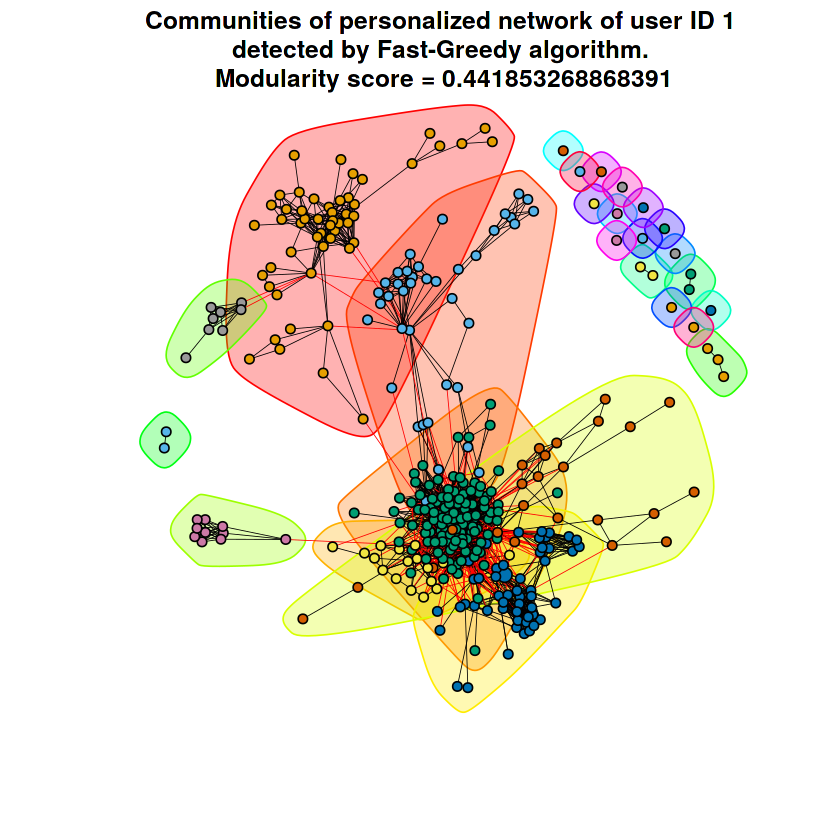

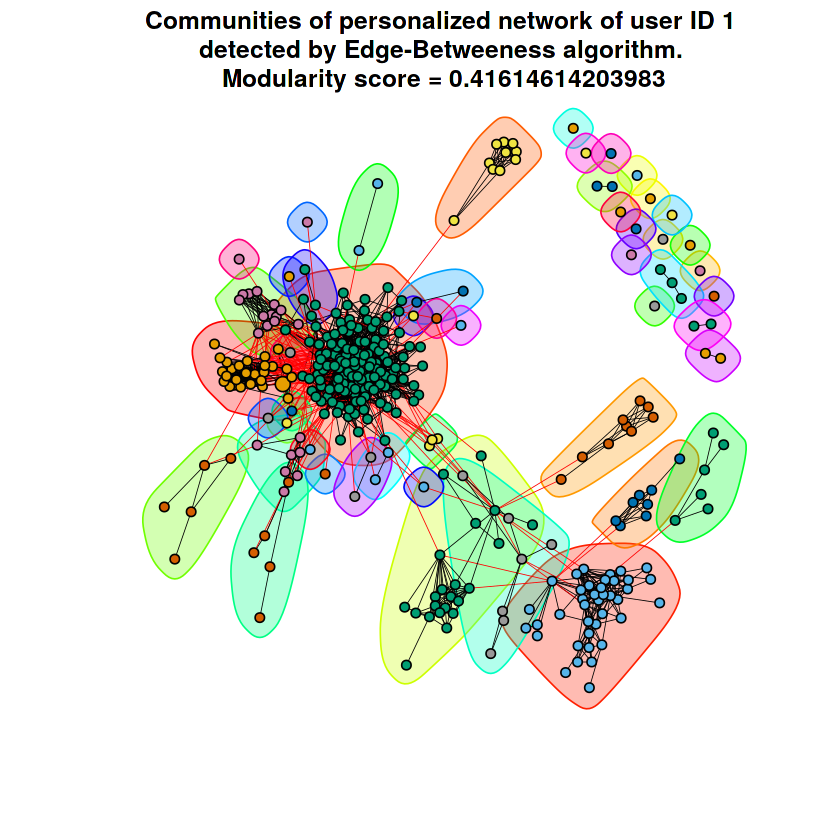

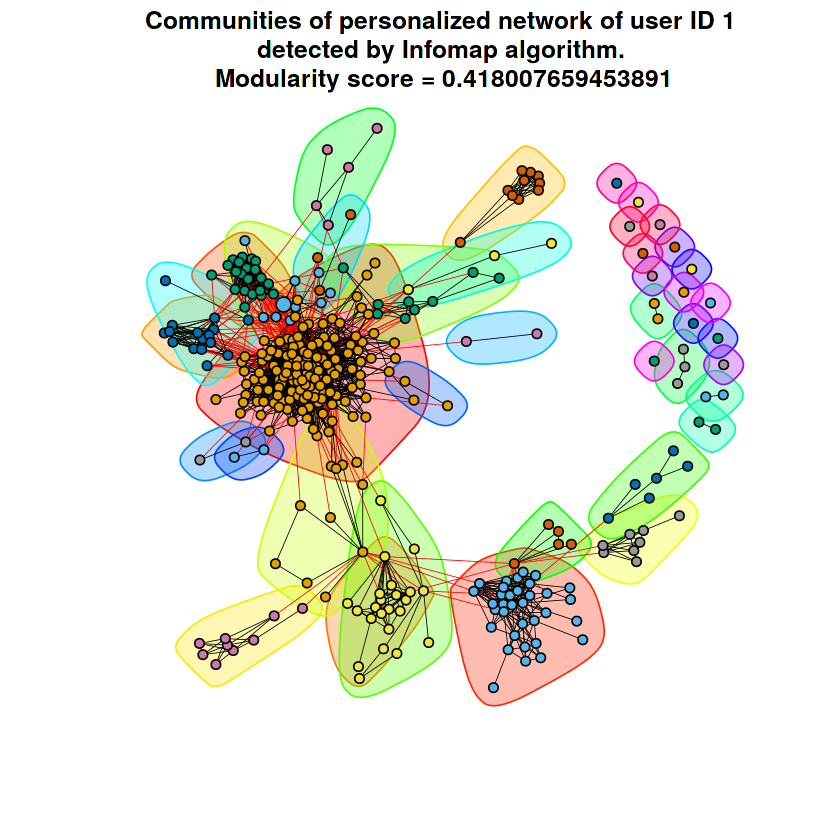

In [0]:
pers_net_comm_detect(g, core_node=1, include_core_node=FALSE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=1, include_core_node=FALSE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=1, include_core_node=FALSE, cluster_infomap, "Infomap")

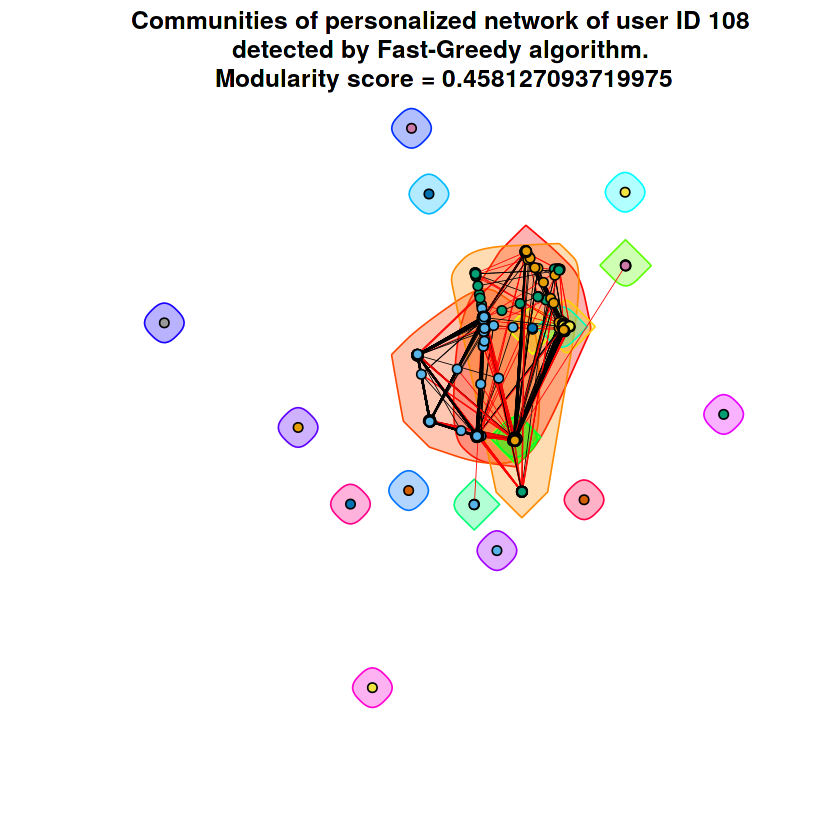

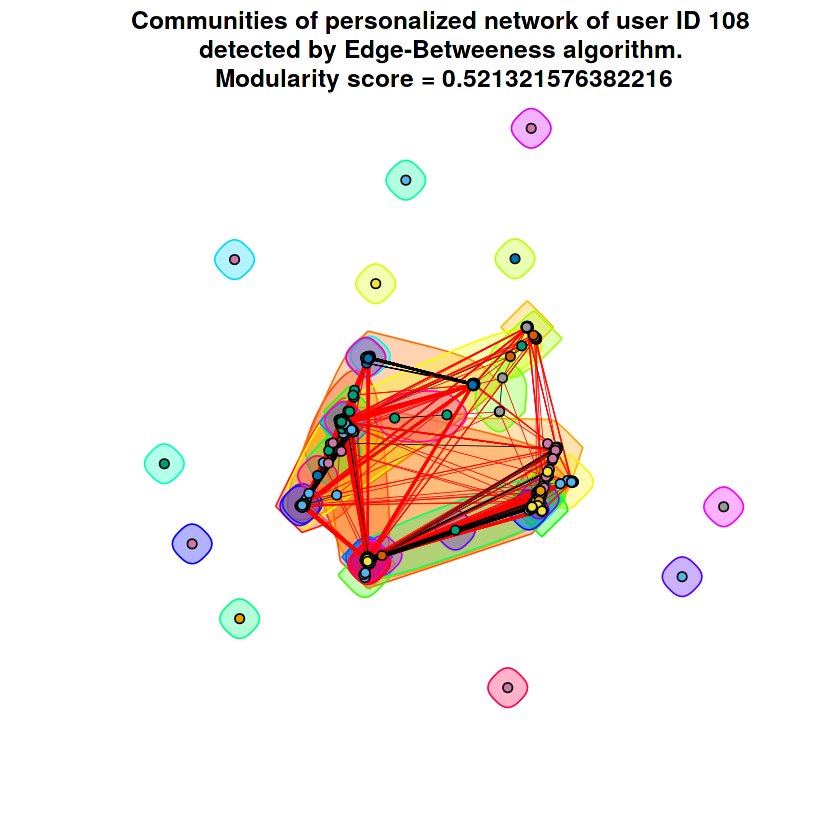

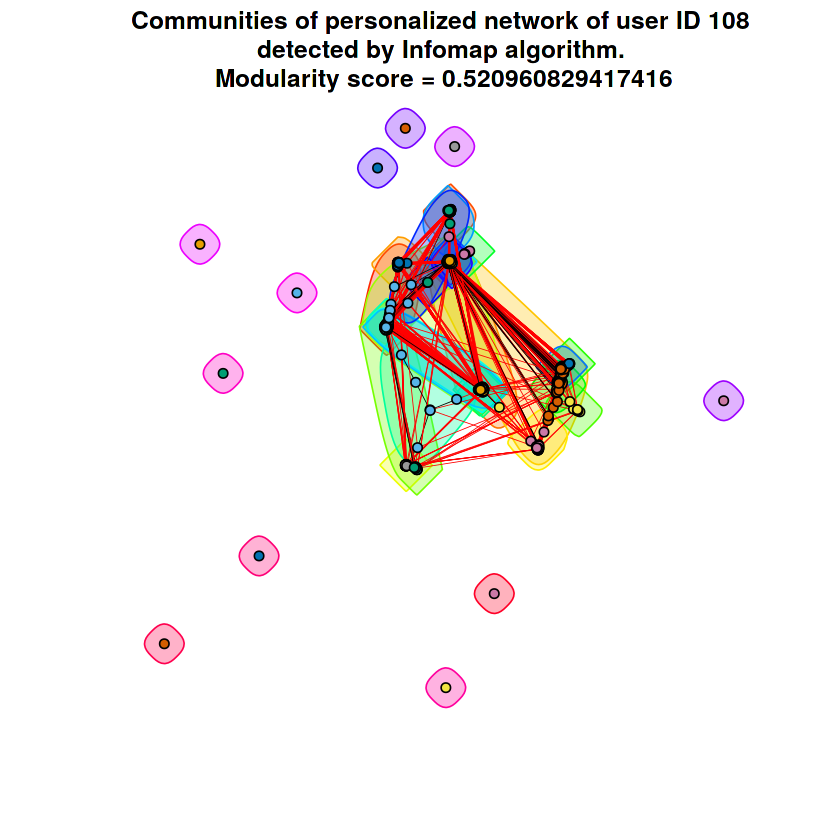

In [0]:
pers_net_comm_detect(g, core_node=108, include_core_node=FALSE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=108, include_core_node=FALSE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=108, include_core_node=FALSE, cluster_infomap, "Infomap")

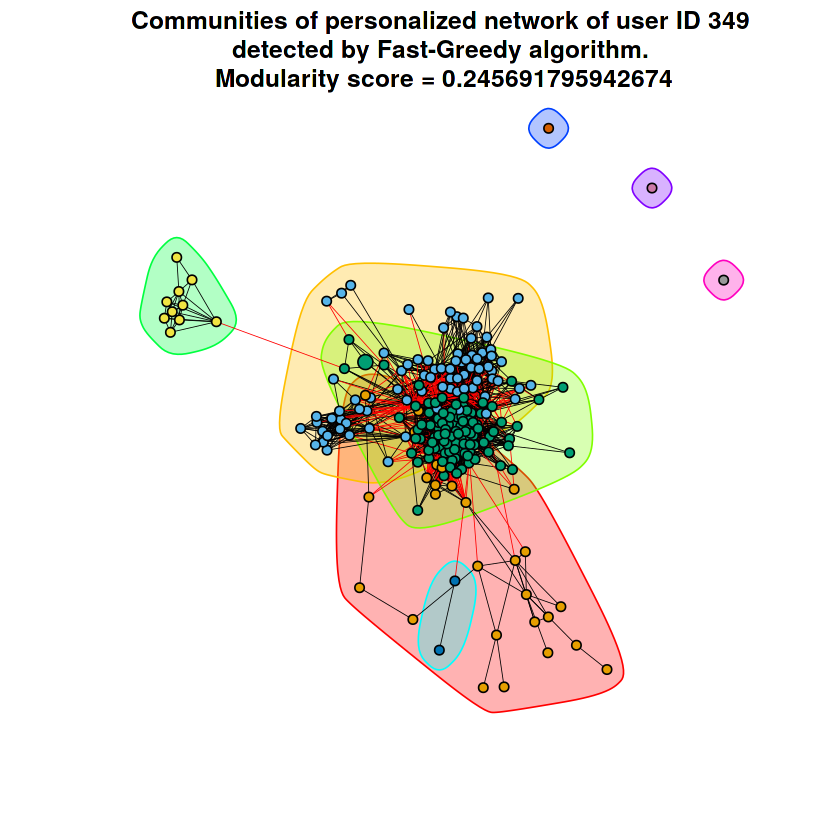

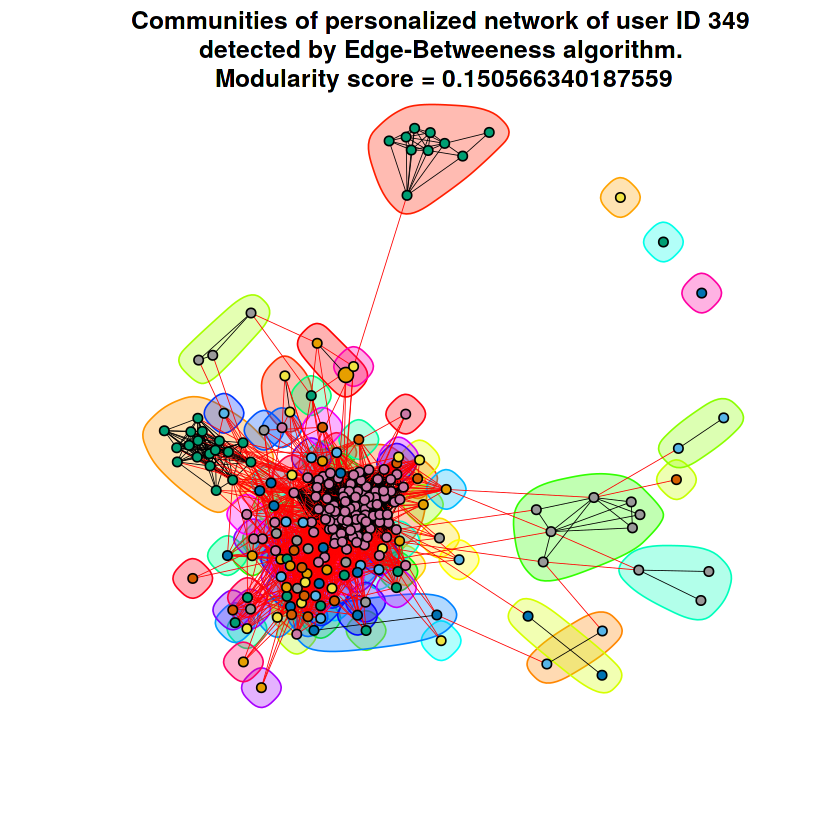

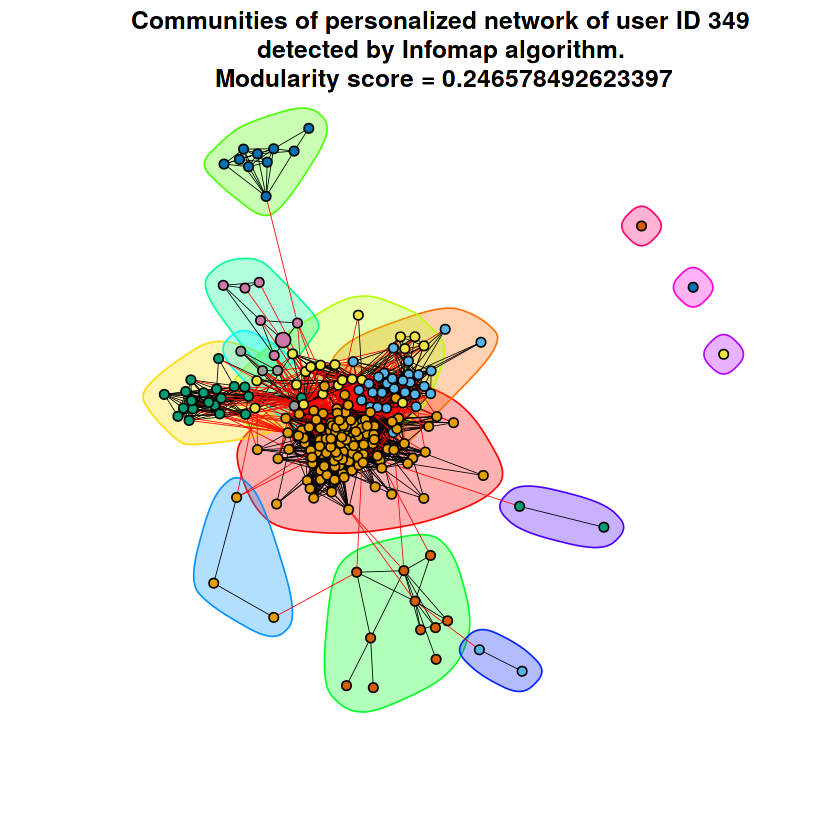

In [0]:
pers_net_comm_detect(g, core_node=349, include_core_node=FALSE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=349, include_core_node=FALSE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=349, include_core_node=FALSE, cluster_infomap, "Infomap")

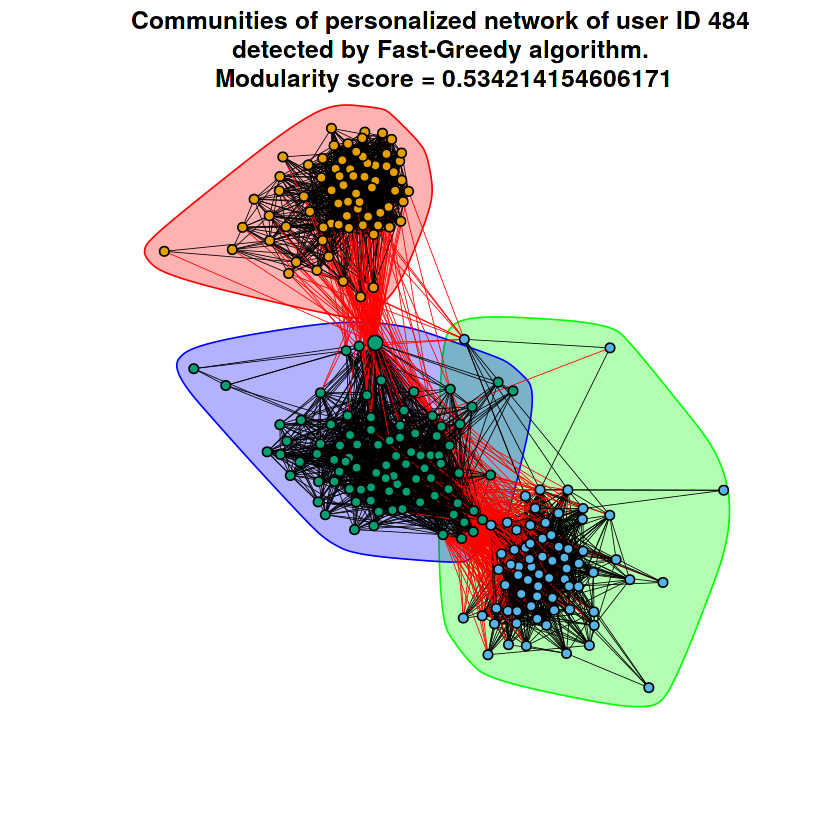

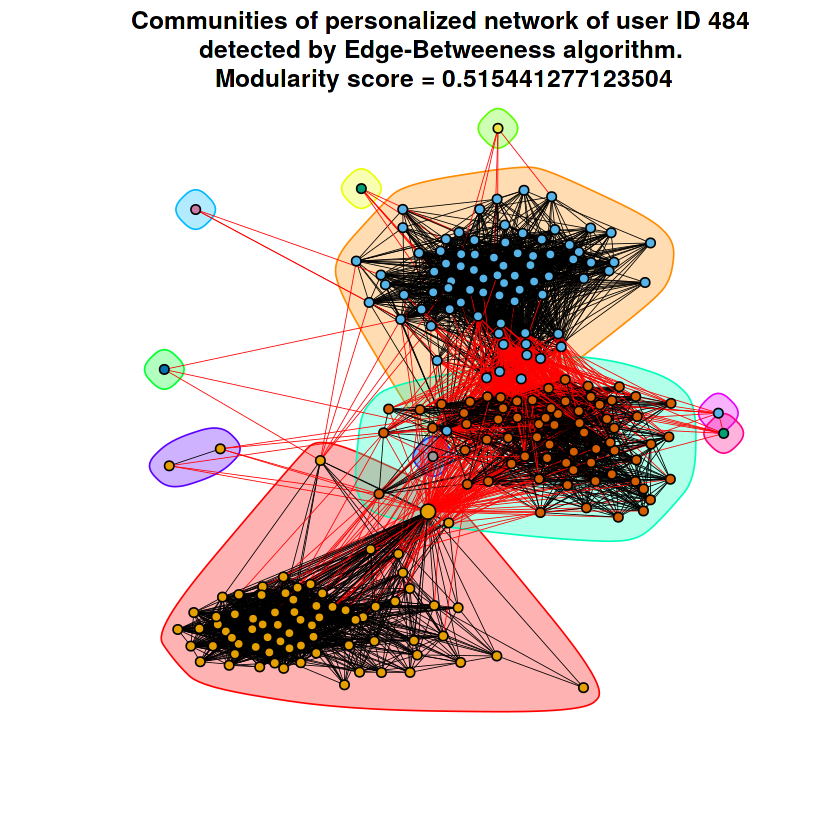

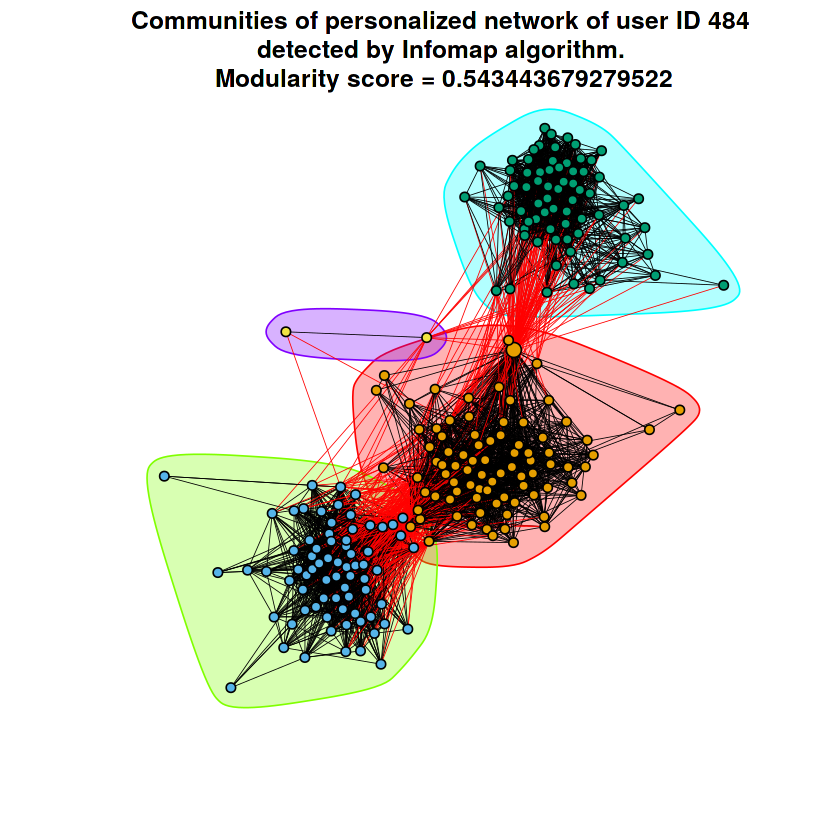

In [0]:
pers_net_comm_detect(g, core_node=484, include_core_node=FALSE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=484, include_core_node=FALSE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=484, include_core_node=FALSE, cluster_infomap, "Infomap")

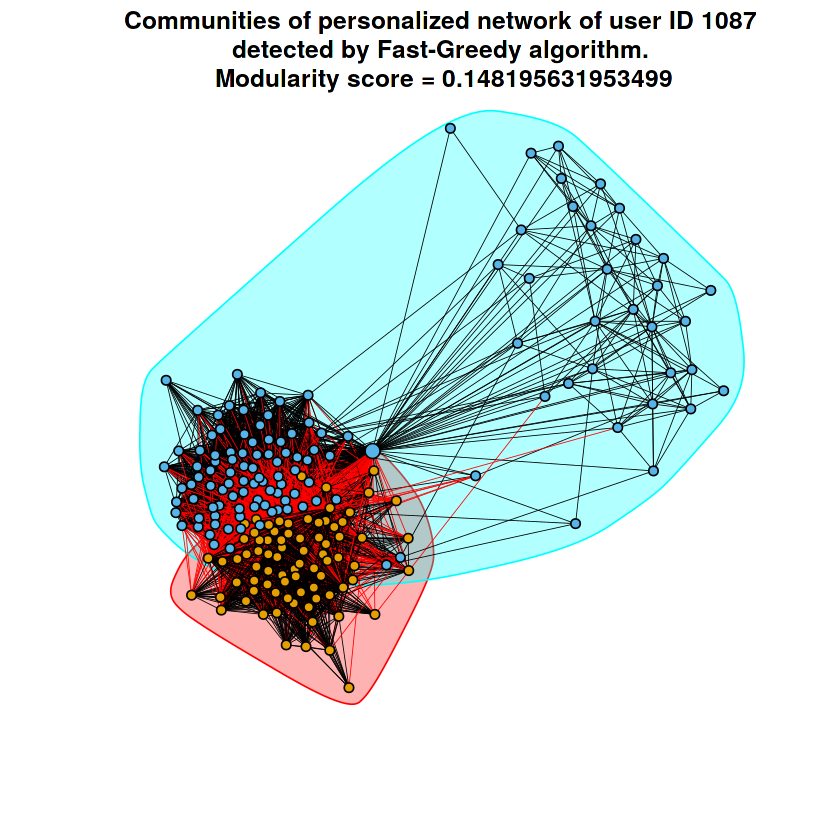

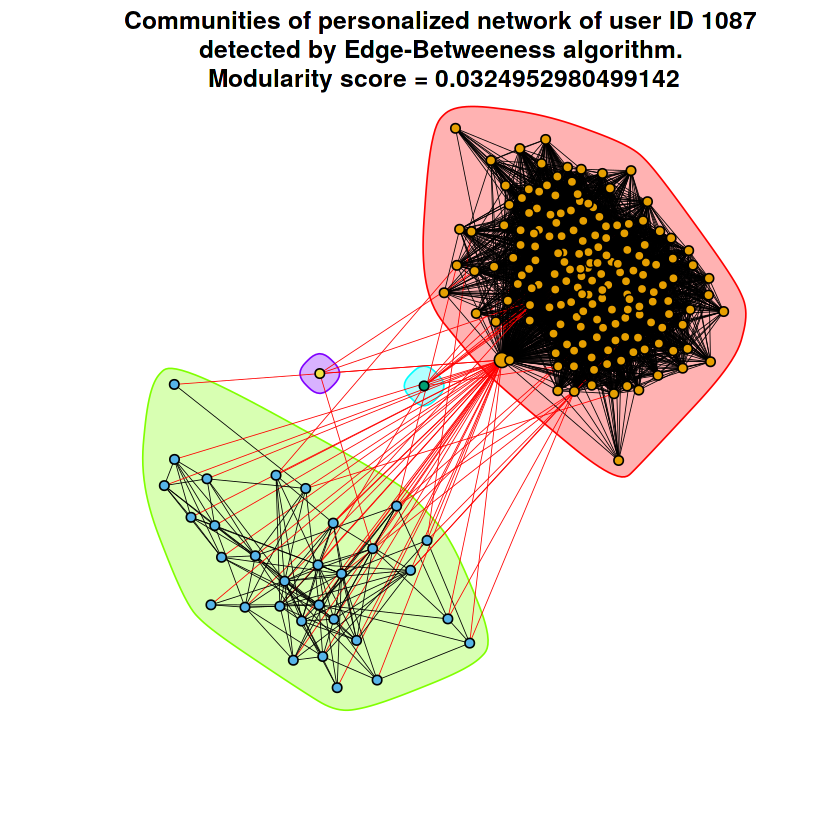

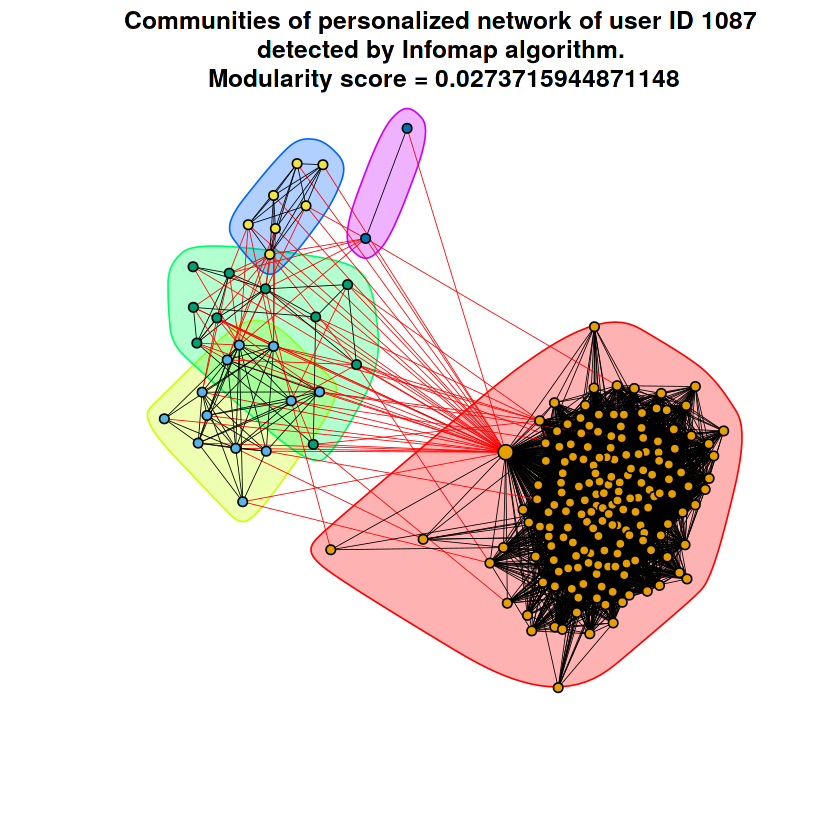

In [0]:
pers_net_comm_detect(g, core_node=1087, include_core_node=FALSE, cluster_fast_greedy, "Fast-Greedy")
pers_net_comm_detect(g, core_node=1087, include_core_node=FALSE, cluster_edge_betweenness, "Edge-Betweeness")
pers_net_comm_detect(g, core_node=1087, include_core_node=FALSE, cluster_infomap, "Infomap")

### Q11-12

In [0]:
g = set_vertex_attr(g, "name", index = V(g), value = V(g))

mutual_friends = function(graph, core_node, node){
    return (intersect(neighbors(graph, core_node), neighbors(graph, node)))
}

embeddedness = function(graph, core_node){
    embeddedness_list = c()
    nodes = neighbors(graph, core_node)
    for (node in nodes){
        embeddedness = length(mutual_friends(graph, core_node, node))
        embeddedness_list = c(embeddedness_list, embeddedness)
    }
    return (list(embeddedness_list = embeddedness_list, node_map = nodes))
}

dispersion = function(graph, core_node){
    dispersion_list = c()
    pers_net = induced_subgraph(graph, c(core_node, neighbors(graph, core_node)))
    d = diameter(pers_net)
    nodes = neighbors(graph, core_node)
    for (node in nodes){
        modified_graph = delete_vertices(graph, c(core_node, node))
        mutualfriends = mutual_friends(graph, core_node, node)
        #map vertex ID of mutualfriends in graph to corresponding ID in modified graph
        #according to original name in graph defined at the very beginning:
        mapped_mutualfriends = match(mutualfriends, V(modified_graph)$name)
        #dist is a square matrix:
        dist = distances(modified_graph, mapped_mutualfriends, mapped_mutualfriends)
        dist[which(is.infinite(dist))] = d
        dispersion = sum(dist)/2
        dispersion_list = c(dispersion_list, dispersion)
    }
    return (list(dispersion_list=dispersion_list, node_map=nodes))
}

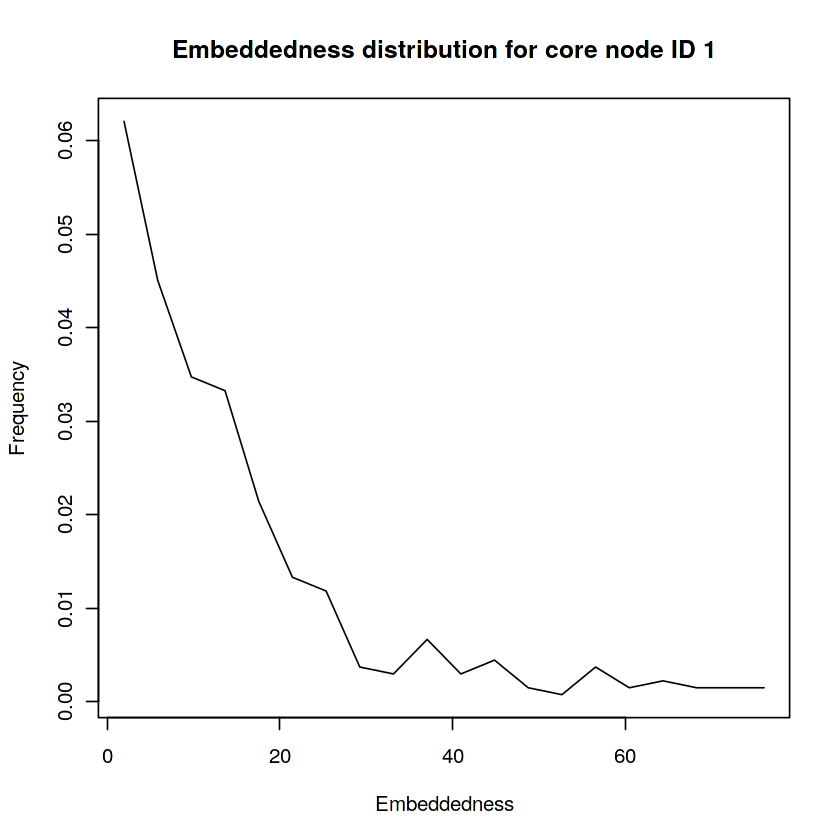

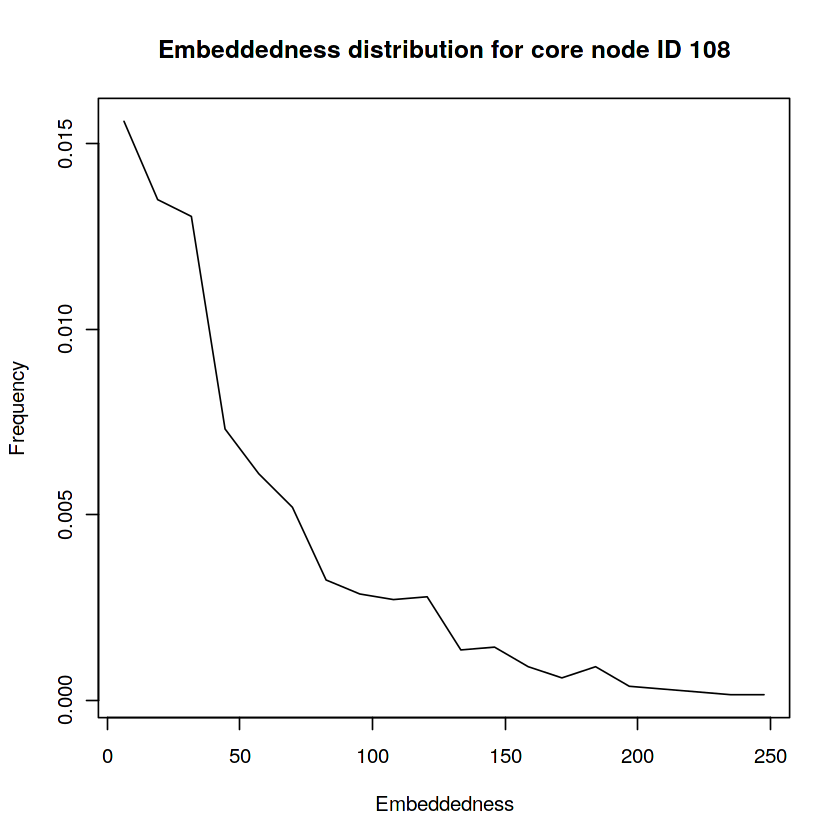

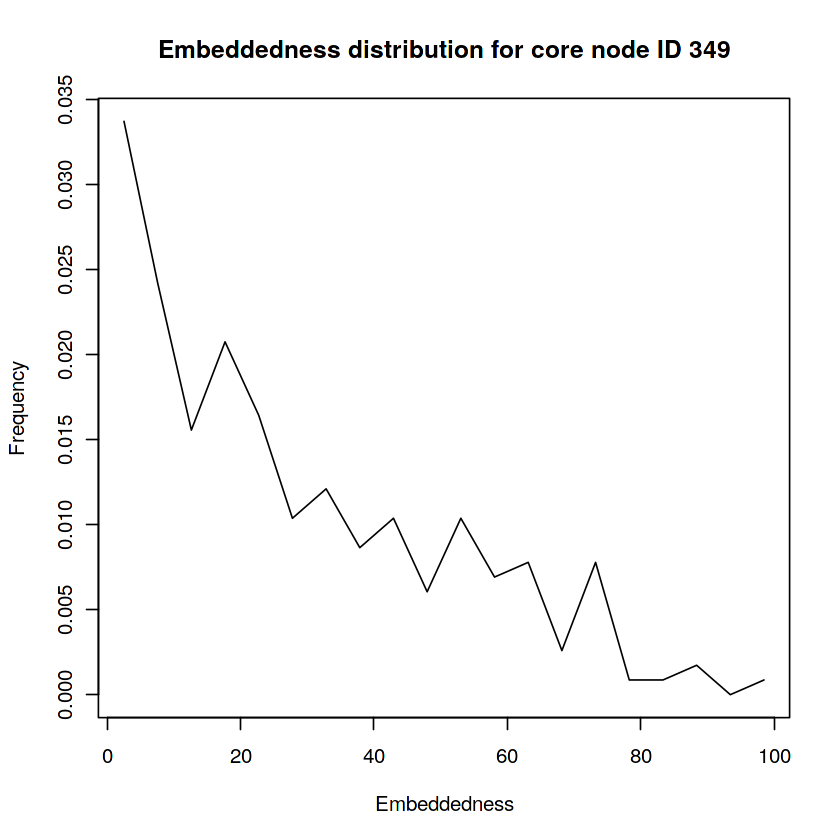

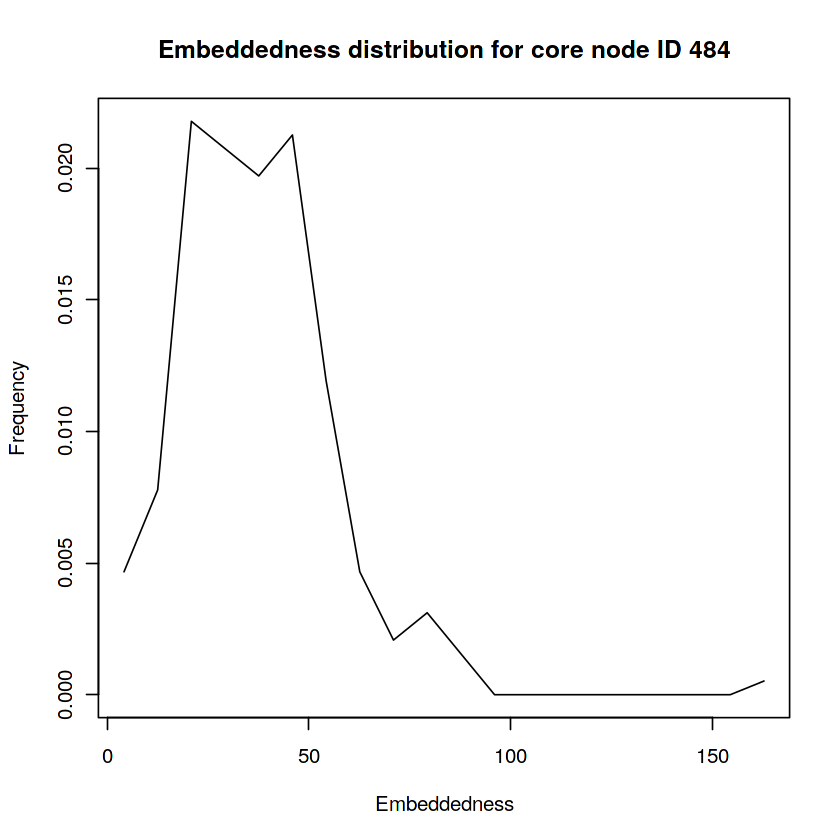

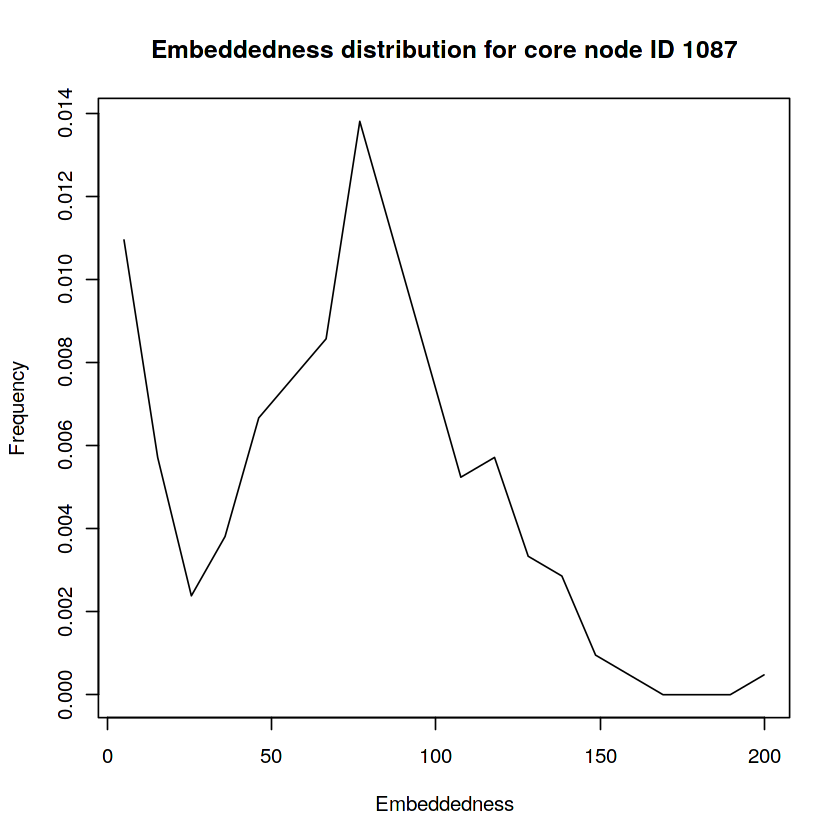

In [0]:
for (core_node in c(1,108,349,484,1087)){
    embeddedness_list = embeddedness(g,core_node)$embeddedness_list
    h=hist(embeddedness_list, breaks=seq(0, (max(embeddedness_list)+1), by=(max(embeddedness_list)+1)/20), plot=FALSE)
    plot(h$mids, h$density, type="l",
         main=paste("Embeddedness distribution for core node ID", core_node),
         xlab="Embeddedness", ylab="Frequency")
}

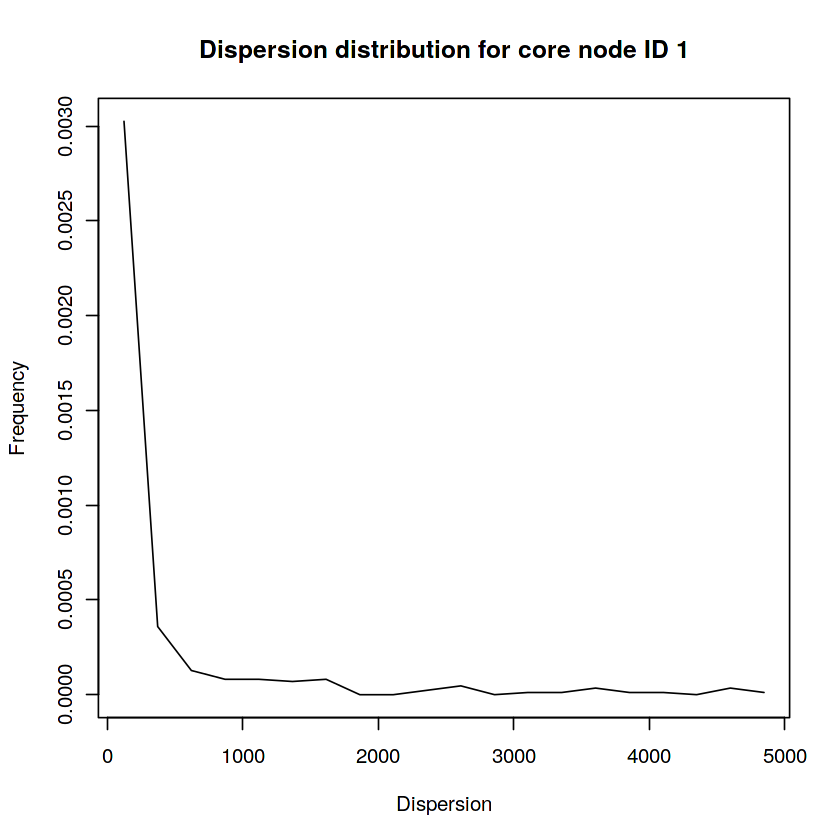

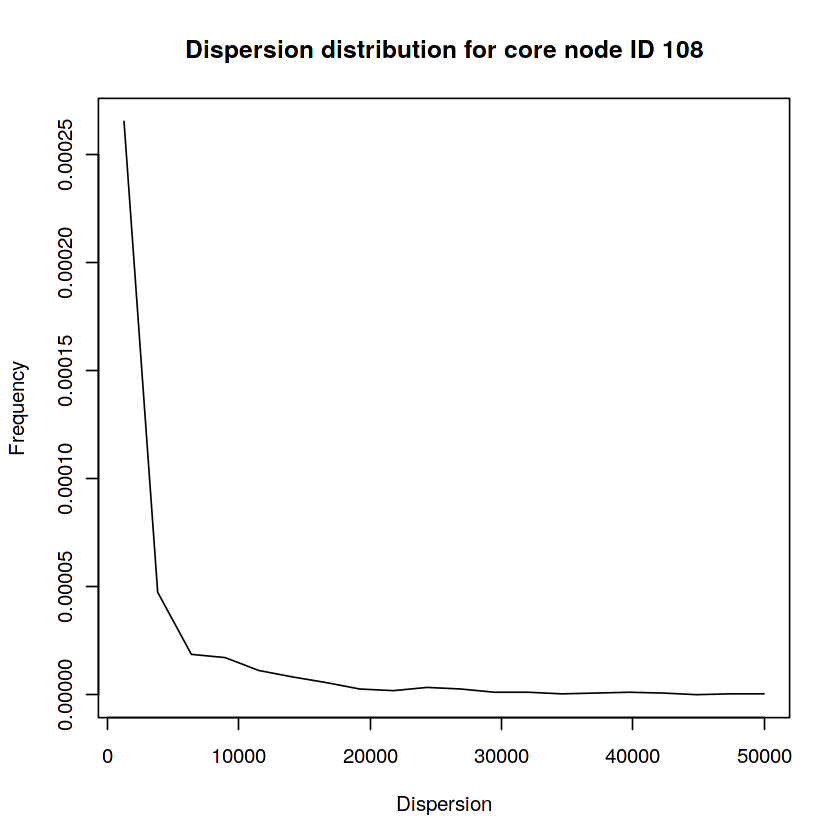

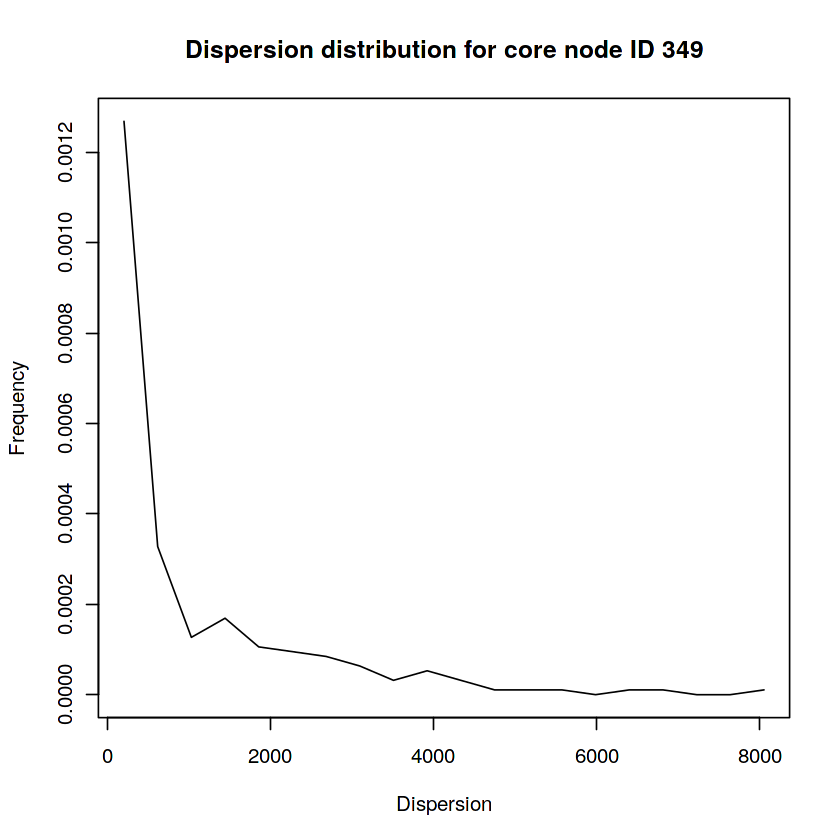

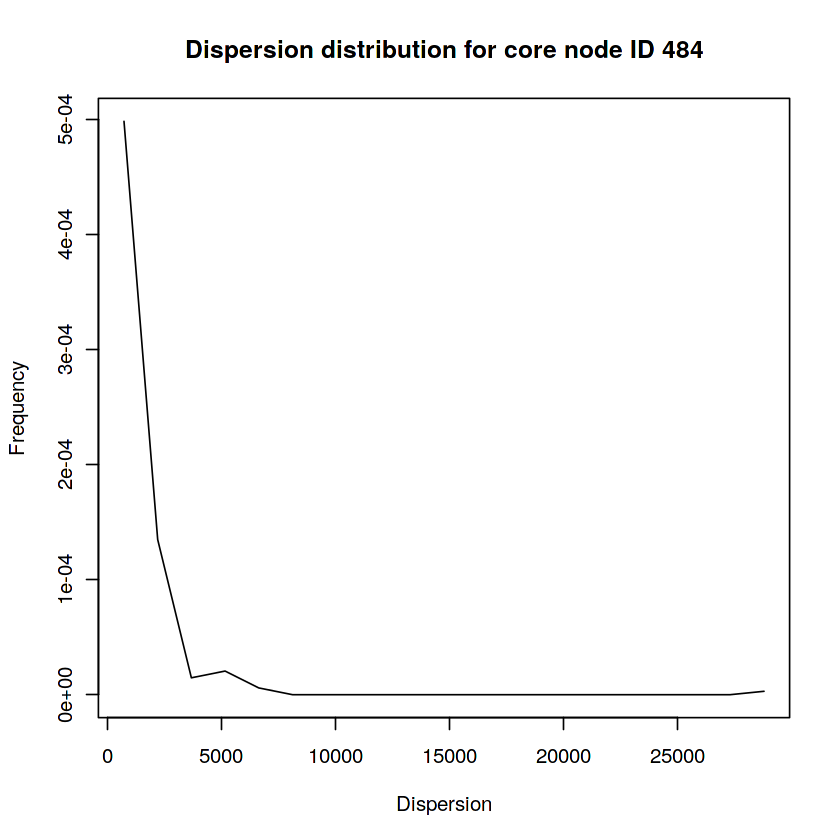

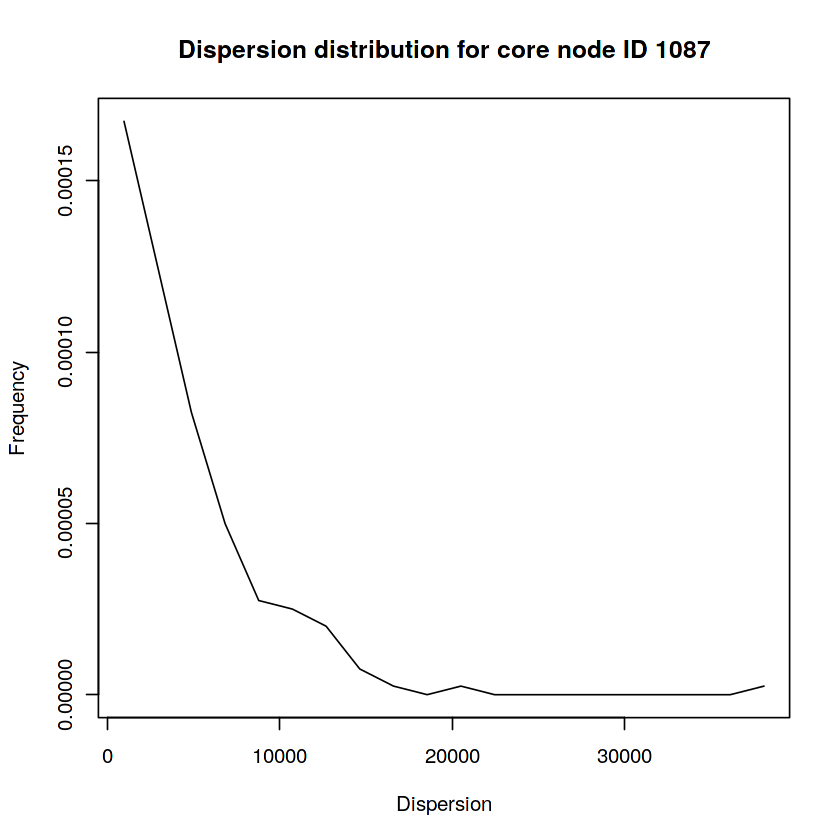

In [0]:
for (core_node in c(1,108,349,484,1087)){
    dispersion_list = dispersion(g,core_node)$dispersion_list
    h=hist(dispersion_list, breaks=seq(0, (max(dispersion_list)+1), by=(max(dispersion_list)+1)/20), plot=FALSE)
    plot(h$mids, h$density, type="l",
         main=paste("Dispersion distribution for core node ID", core_node),
         xlab="Dispersion", ylab="Frequency")
}

### Q13

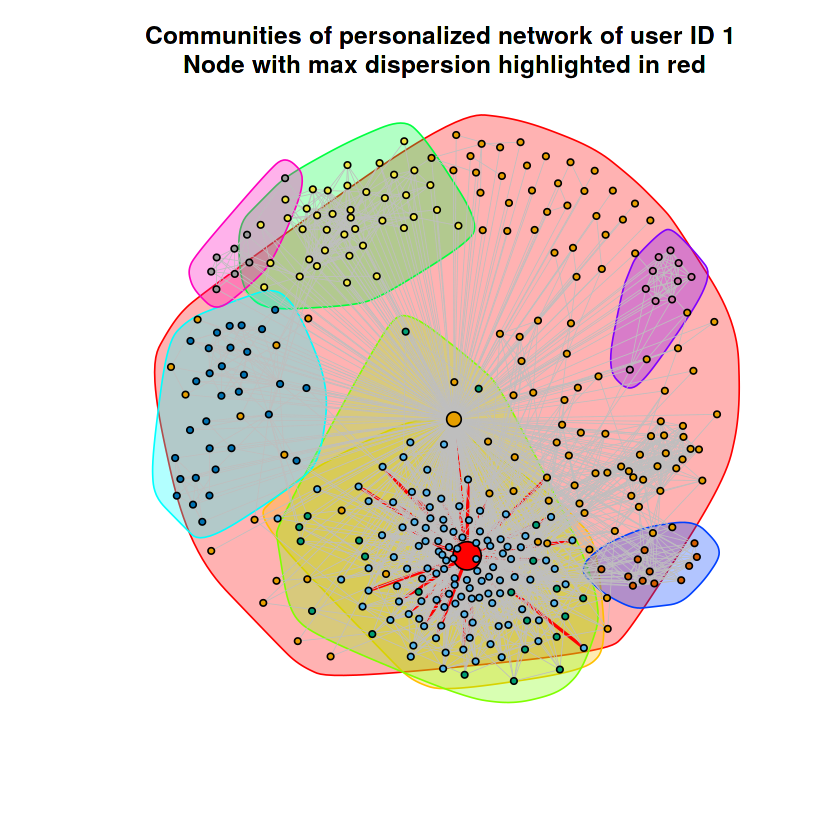

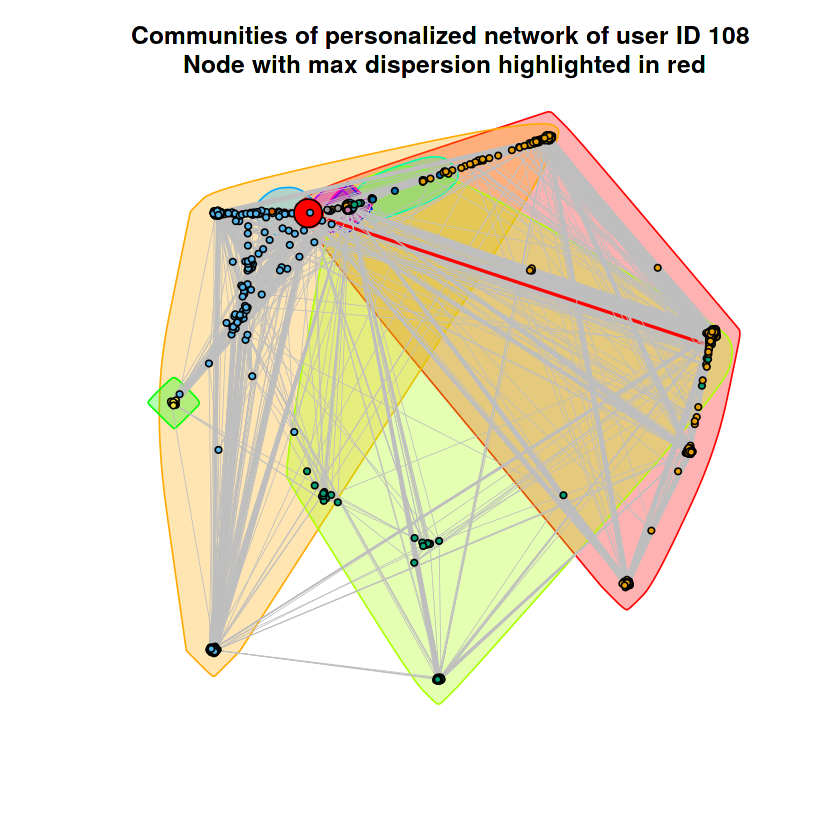

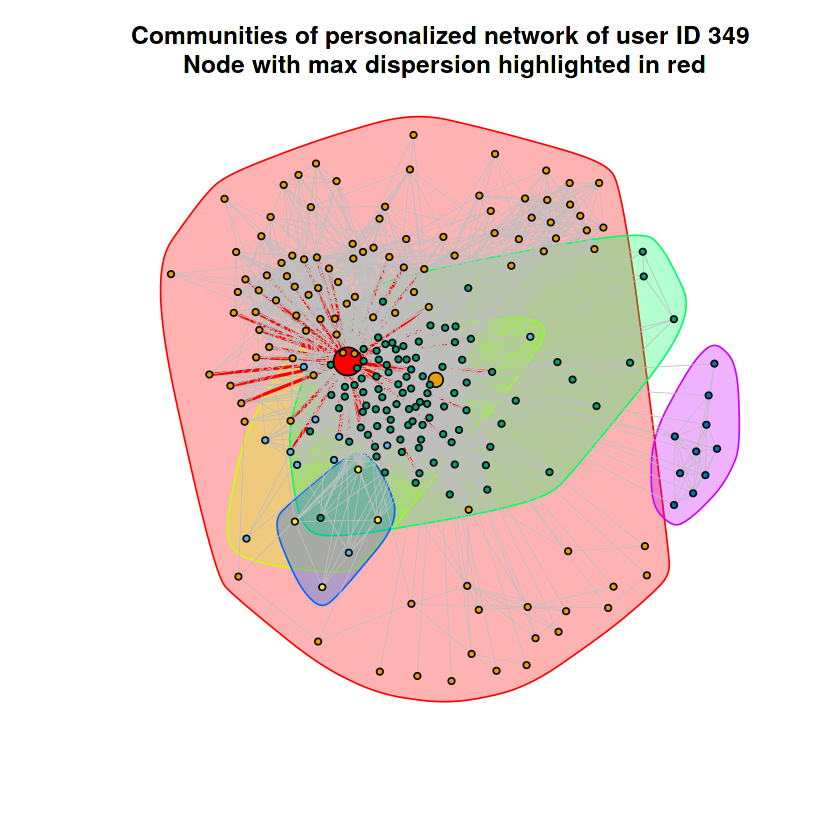

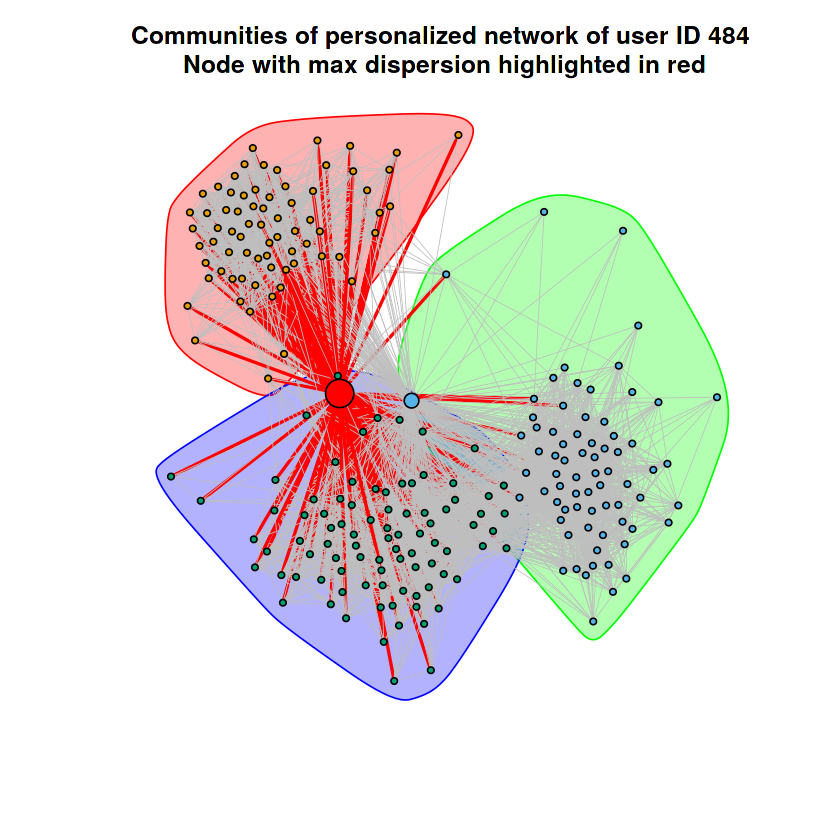

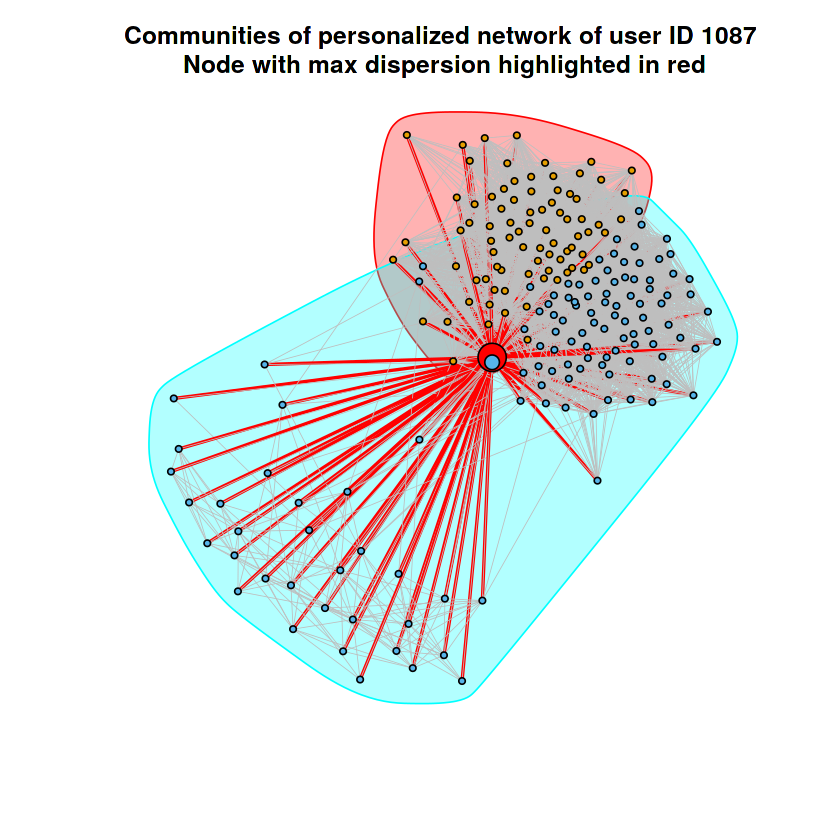

In [0]:
# Q13
for (core_node in c(1,108,349,484,1087)){
    dispersion_list = dispersion(g,core_node)$dispersion_list
    dispersion_node_map = dispersion(g,core_node)$node_map
    max_node = dispersion_node_map[which(dispersion_list==max(dispersion_list))]
    pers_net = induced_subgraph(g, c(core_node, neighbors(g, core_node)))
    mapped_max_node = match(max_node, V(pers_net)$name)
    mapped_core_node = match(core_node, V(pers_net)$name)
    comm = cluster_fast_greedy(pers_net)
    modularity_score = modularity(pers_net, membership(comm))

    vertex_size = rep(2, vcount(pers_net))
    vertex_size[mapped_core_node] = 5
    vertex_size[mapped_max_node] = 10
    vertex_color = comm$membership
    vertex_color[mapped_max_node] = "red"
    max_node_edge = which(as_edgelist(pers_net, name=FALSE)[,1]==mapped_max_node | as_edgelist(pers_net, name=FALSE)[,2]==mapped_max_node)
    edge_color = rep("gray", ecount(pers_net))
    edge_color[max_node_edge] = "red"
    edge_width = rep(0.5, ecount(pers_net))
    edge_width[max_node_edge] = 2
    plot(comm, pers_net,
         vertex.label = NA, vertex.size = vertex_size, col = vertex_color,
         edge.color = edge_color, edge.width=edge_width,
         main = paste("Communities of personalized network of user ID", core_node, 
                      "\nNode with max dispersion highlighted in red"
#                       "\nMax dispersion =", max(dispersion_list),
#                       "\nModularity score =", modularity_score
                     ))
}

### Q14-15

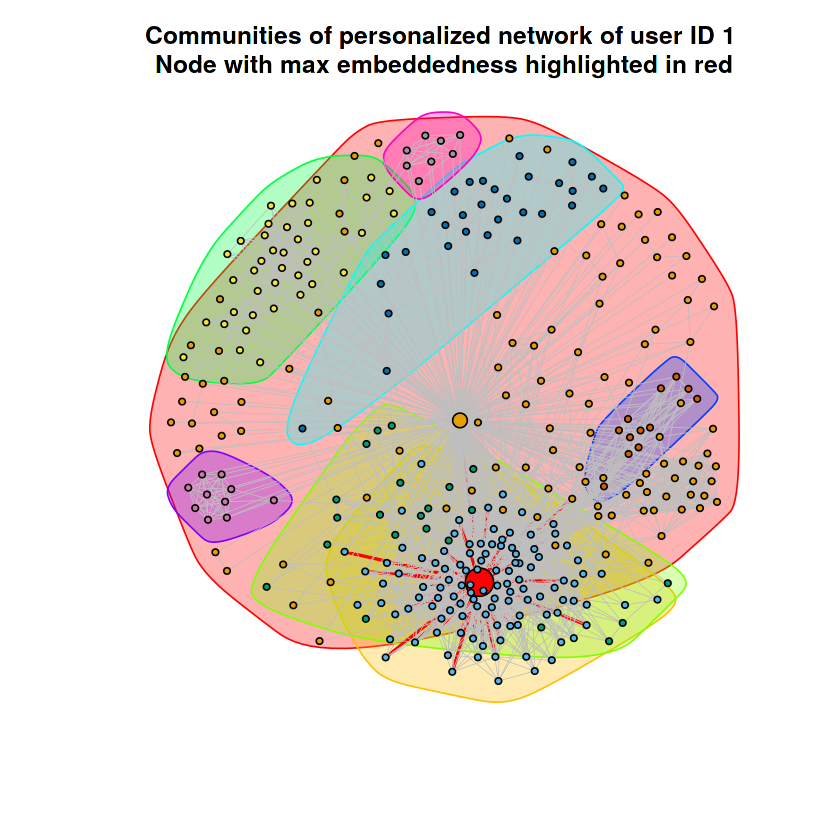

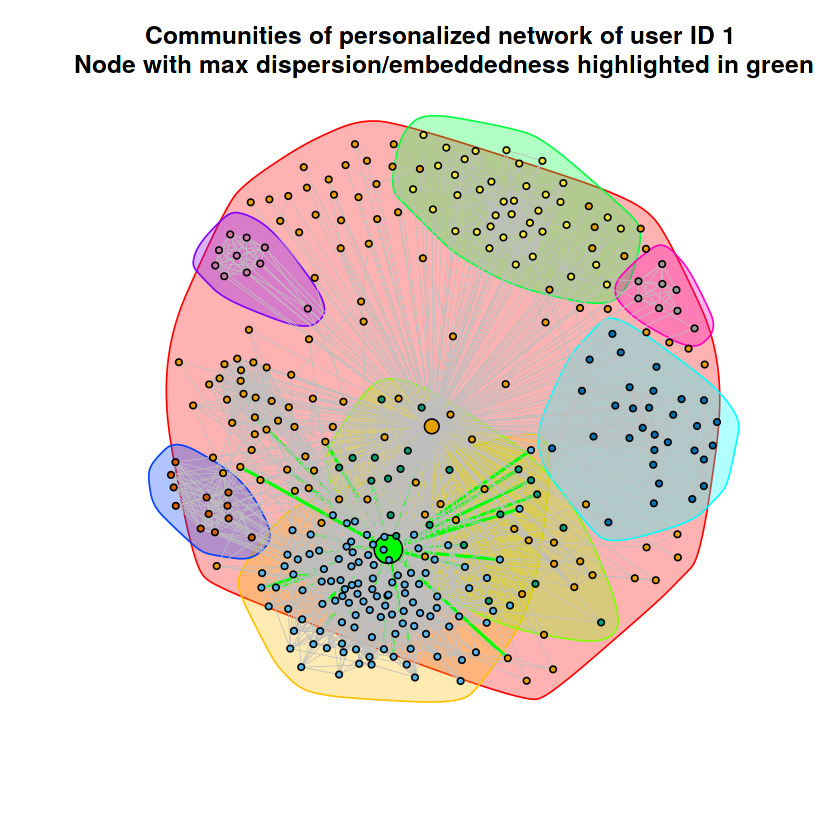

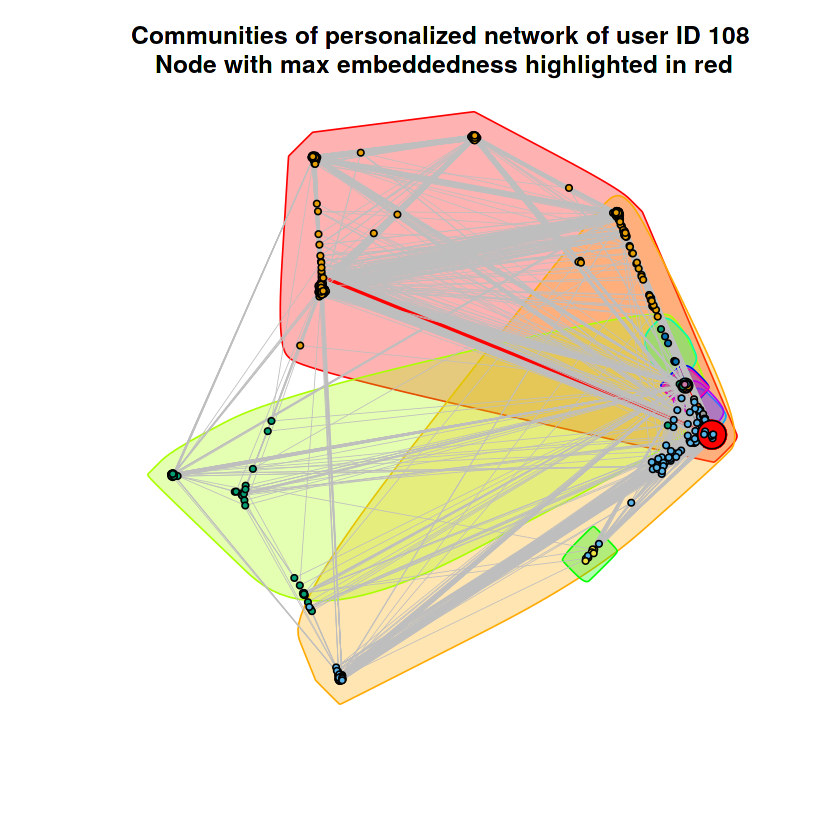

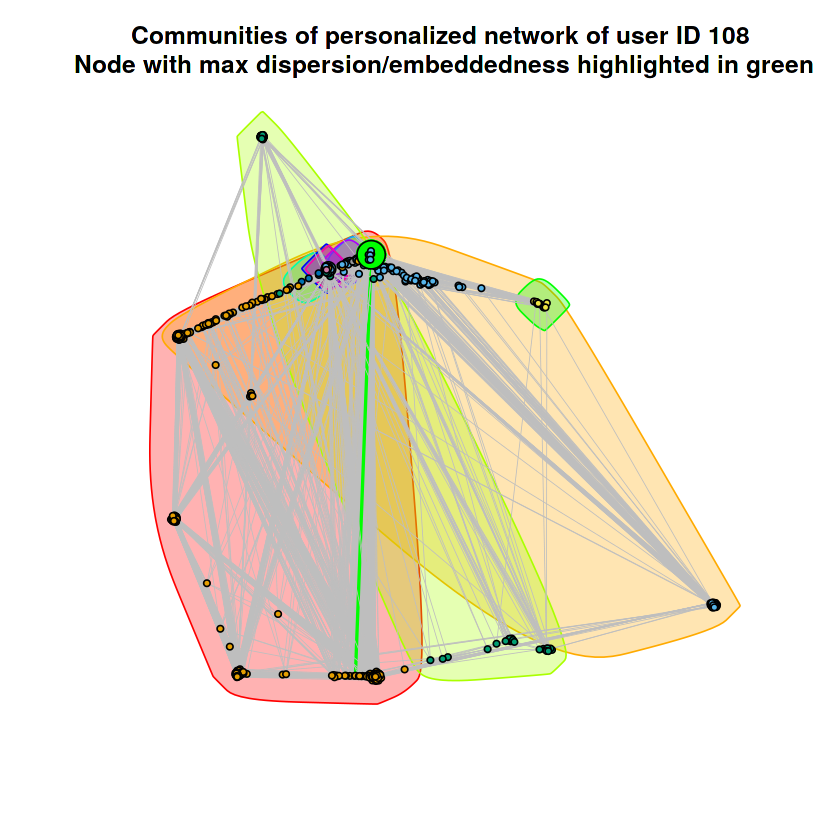

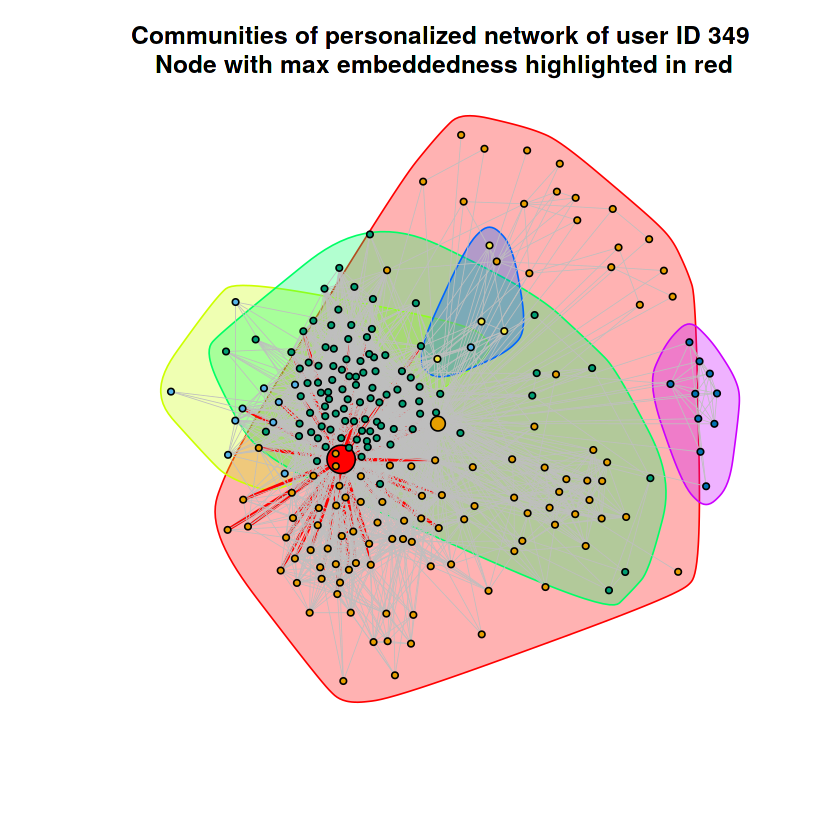

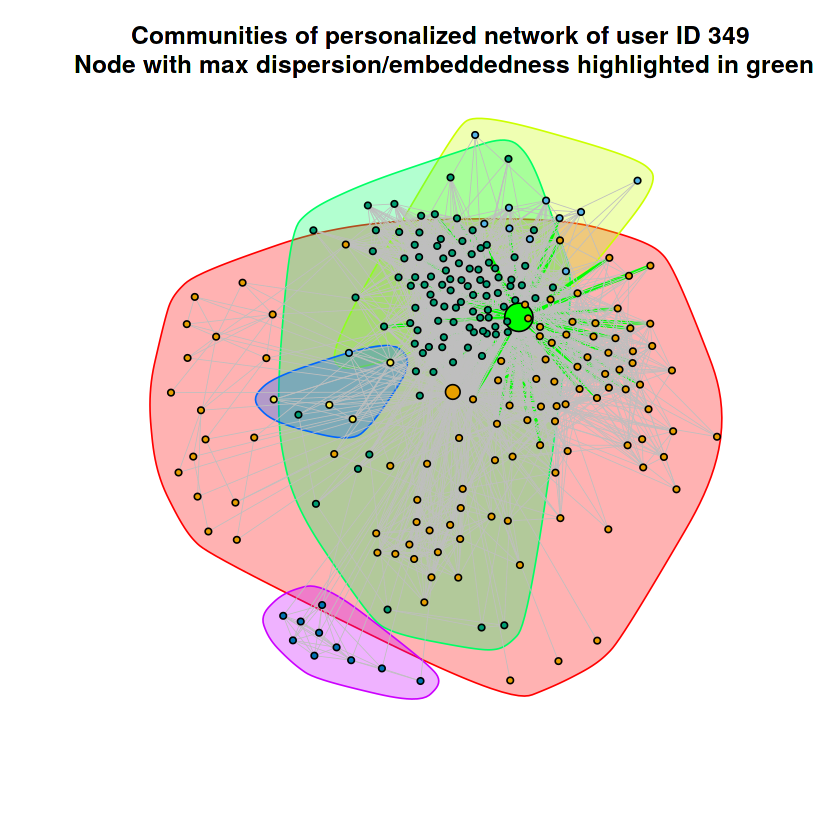

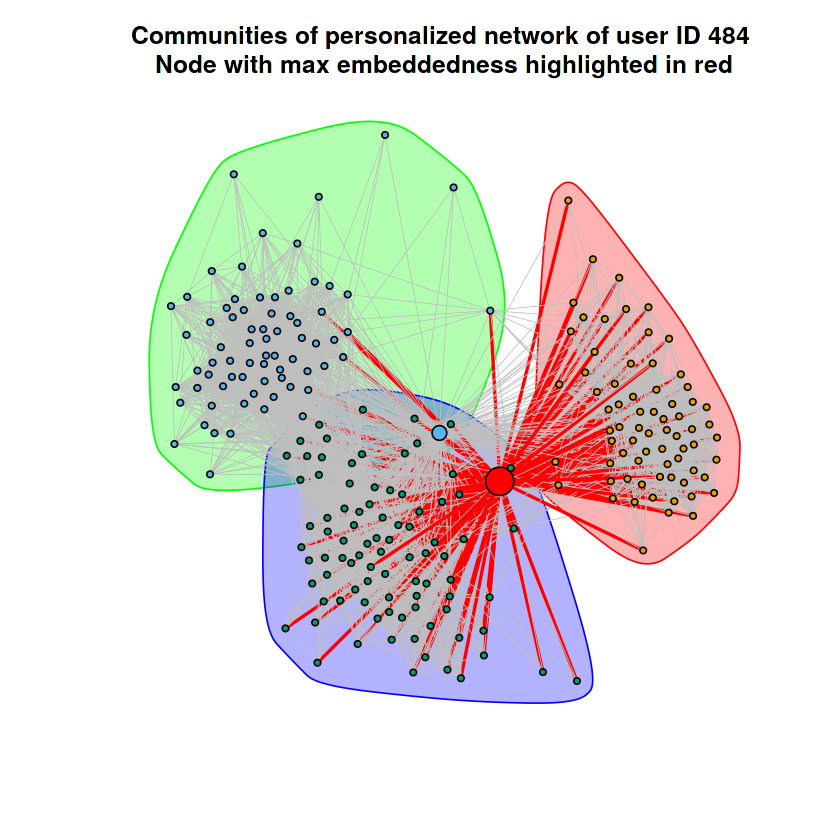

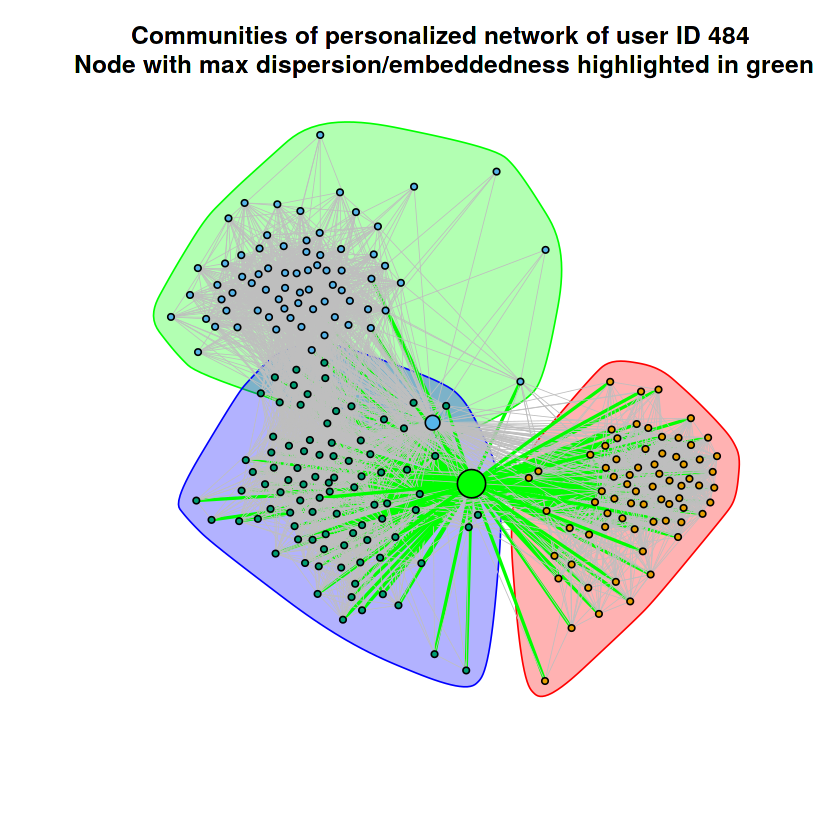

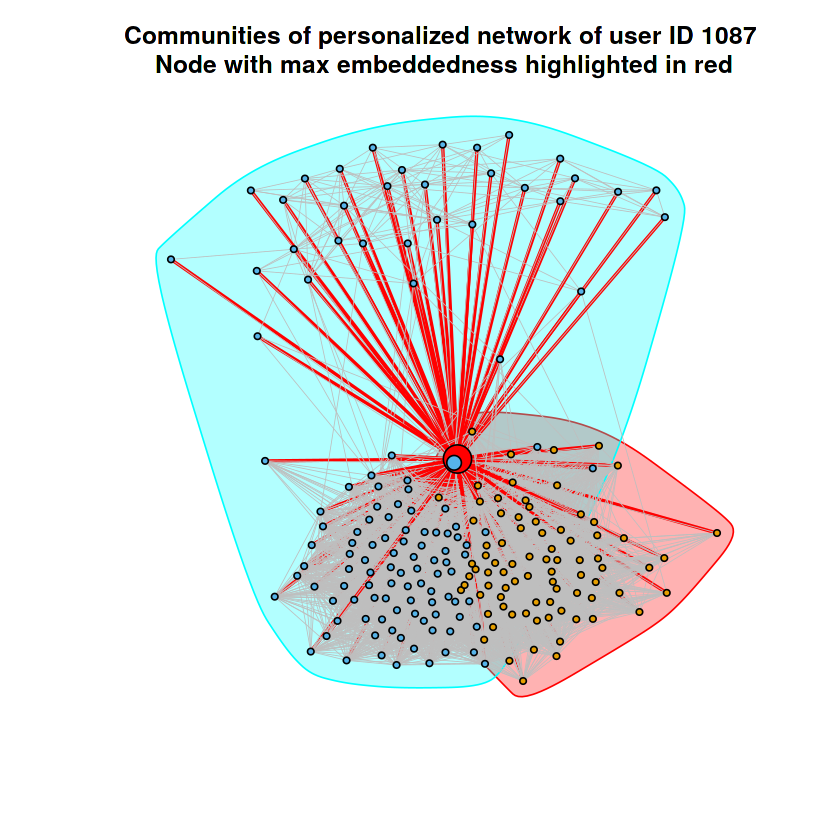

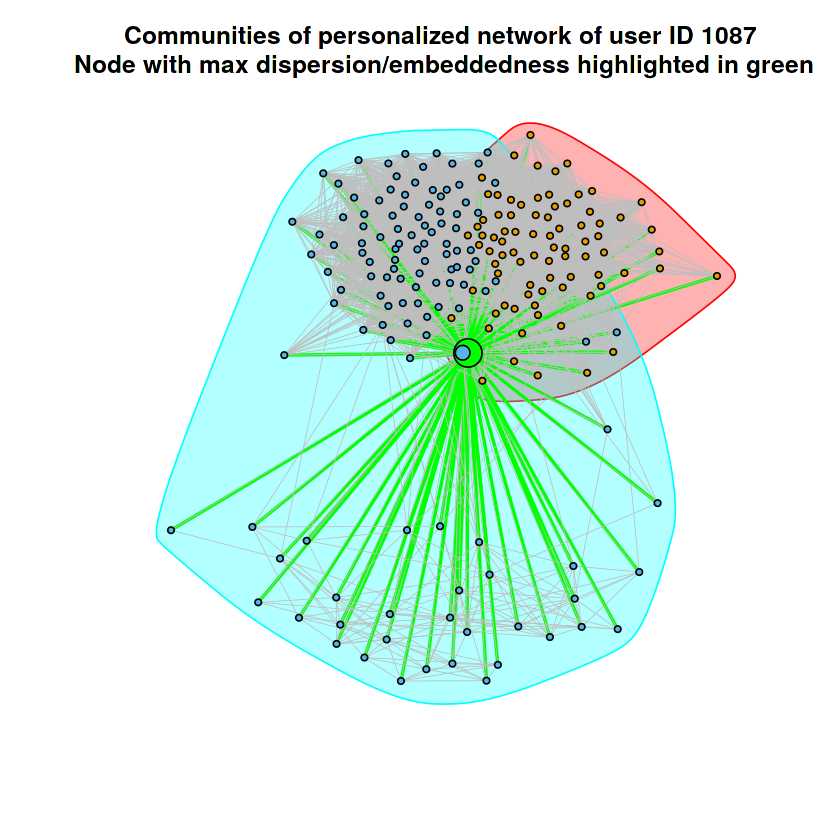

In [0]:
# Q14
for (core_node in c(1,108,349,484,1087)){
    dispersion_list = dispersion(g,core_node)$dispersion_list
    dispersion_node_map = dispersion(g,core_node)$node_map
    embeddedness_list = embeddedness(g,core_node)$embeddedness_list
    embeddedness_node_map = embeddedness(g,core_node)$node_map #identical to dispersion_node_map
    
    disp_embed_ratio = dispersion_list/embeddedness_list
    disp_embed_ratio[which(is.nan(disp_embed_ratio))] = -1 #don't count the node which yields NaN ratio
    max_node = embeddedness_node_map[which(embeddedness_list==max(embeddedness_list))]
    max_ratio_node = dispersion_node_map[which(disp_embed_ratio==max(disp_embed_ratio))]
    pers_net = induced_subgraph(g, c(core_node, neighbors(g, core_node)))
    mapped_core_node = match(core_node, V(pers_net)$name)
    mapped_max_node = match(max_node, V(pers_net)$name)
    mapped_max_ratio_node = match(max_ratio_node, V(pers_net)$name)

    comm = cluster_fast_greedy(pers_net)
    modularity_score = modularity(pers_net, membership(comm))

    vertex_size1 = rep(2, vcount(pers_net))
    vertex_size1[mapped_core_node] = 5
    vertex_size1[mapped_max_node] = 10
    vertex_color1 = comm$membership
    vertex_color1[mapped_max_node] = "red"
    max_node_edge = which(as_edgelist(pers_net, name=FALSE)[,1]==mapped_max_node 
                          | as_edgelist(pers_net, name=FALSE)[,2]==mapped_max_node)
    edge_color1 = rep("gray", ecount(pers_net))
    edge_color1[max_node_edge] = "red"
    edge_width1 = rep(0.5, ecount(pers_net))
    edge_width1[max_node_edge] = 2
    plot(comm, pers_net,
         vertex.label = NA, vertex.size = vertex_size1, col = vertex_color1,
         edge.color = edge_color1, edge.width=edge_width1,
         main = paste("Communities of personalized network of user ID", core_node,
                      "\nNode with max embeddedness highlighted in red"
#                       "\nModularity score =", modularity_score
                     ))
    
    vertex_size2 = rep(2, vcount(pers_net))
    vertex_size2[mapped_core_node] = 5
    vertex_size2[mapped_max_ratio_node] = 10
    vertex_color2 = comm$membership
    vertex_color2[mapped_max_ratio_node] = "green"
    max_ratio_node_edge = which(as_edgelist(pers_net, name=FALSE)[,1]==mapped_max_ratio_node 
                                | as_edgelist(pers_net, name=FALSE)[,2]==mapped_max_ratio_node)
    edge_color2 = rep("gray", ecount(pers_net))
    edge_color2[max_ratio_node_edge] = "green"
    edge_width2 = rep(0.5, ecount(pers_net))
    edge_width2[max_ratio_node_edge] = 2
    plot(comm, pers_net,
         vertex.label = NA, vertex.size = vertex_size2, col = vertex_color2,
         edge.color = edge_color2, edge.width=edge_width2,
         main = paste("Communities of personalized network of user ID", core_node,
                      "\nNode with max dispersion/embeddedness highlighted in green"
#                       "\nModularity score =", modularity_score
                     ))
}

### Q16

In [0]:
library(igraph)
setwd("C:/Users/Carlo/Desktop/grad/3-spring2019/232e/project2/")
fb_read <- read_graph("facebook_combined.txt", directed = FALSE)
fb_el <- as_edgelist(fb_read)
g = graph_from_edgelist(fb_el, directed = FALSE)


In [0]:
id = 415
id_neighbors = neighbors(g, v = id)
g1 <- induced_subgraph(g, v = c(id, id_neighbors))

In [0]:
Nr <- list()
j = 1
for (i in 1:length(V(g1))) {
    if (degree(g1, v=i) == 24) {
        Nr[[j]] <- i
        j = j + 1
    }
}

Nr

# Size of Nr is 11

[[1]]
[1] 31

[[2]]
[1] 53

[[3]]
[1] 75

[[4]]
[1] 90

[[5]]
[1] 93

[[6]]
[1] 102

[[7]]
[1] 118

[[8]]
[1] 133

[[9]]
[1] 134

[[10]]
[1] 136

[[11]]
[1] 137

### Q17

In [0]:
# Common neighbors
# cn(i, j) = | Si intersect Sj |, where Sx is the neighbor set of node x in the network

# For each node in Nr, remove each of its edges with probability 0.25. These removed edges correspond to nodes, put them in Ri
# Use common neighbors metric to find the |Ri| nodes with highest # of common neighbors (greatest value for this metric)
# The list of these friends recommended by common neighbors is Pi 
# Take accuracy of this : |Pi intersect Ri| / |Ri|
# Repeat 10 times and take the average of the accuracies. 

# Find common neighbors of nodes i, j in graph g
common_neighbors <- function(g, node_i, node_j) {
  neighbors_i = neighbors(g, node_i)
  neighbors_j = neighbors(g, node_j)
  return(length(intersection(neighbors_i, neighbors_j)))
}

avg_accuracies <- vector()
for (user in 1:length(Nr)) {
    accuracies <- vector()
    for (i in 1:10) { # make 1:10 later
        user_neighbors = neighbors(g1, Nr[user]) # Get neighbors of a user in Nr
        R_user = sample(user_neighbors, length(user_neighbors)/4, replace = FALSE) # Randomly chosen neighbors of Nr user
        
        # Remove edges in R_user from g1
        es = E(g1)[Nr[user] %--% R_user] # Edge sequence of edges between the Nr user and its randomly chosen neighbors

        new_g = g1 - es # Remove edges from Nr user to the randomly chosen neighbors
        
        # new_g is g1 with the edges of the randomly picked neighbors removed
        
        nodes_to_check = difference((V(new_g)), neighbors(new_g, Nr[user])) # nodes that are not neighbors of Nr user
        #print("Nodes to check")
        #print(nodes_to_check)
        
        values <- vector()
        for (v in 1:length(nodes_to_check)) {
            values = append(values, common_neighbors(new_g, Nr[user], nodes_to_check[v]))
        }
        #print("Values")
        #print(values)
        
        
        #print(str(values)) # shows type of variable
        
        #print("convert graph to vector?")
        nodes_to_check = as_ids(nodes_to_check) # convert vector sequence to regular vector 
        #print(str(nodes_to_check))
            
        sorted_values <- sort(values, decreasing = TRUE)
        #print("Sorted values")
        #print(sorted_values)
        
        recommended <- vector()
        
        for (r in 1:length(R_user)) {
            
            #print("Where does the sorted values come up in the unsorted values?")
            #print(which(sorted_values[r] == values))
            node_to_add <- c(which(sorted_values[r] == values))#[1] 
            recommended = append(recommended, node_to_add)
        }
        recommended = recommended[!duplicated(recommended)] # use these indices to get actual IDs of recommended friends
        #print("recommended friends (indexes)")
        #print(recommended)
        #print("recommended friends (id)")
        #print(nodes_to_check[recommended])
        #print("take intersection of 2 vectors")
        #print(intersect(nodes_to_check, recommended))
        
        #print("these nodes were removed from the user's original friends:")
        #print(R_user)
        
        #print("accuracy")
        #print(length(intersect(nodes_to_check[recommended], R_user)) / length(R_user))
        
        # For all nodes that are NOT in user_neighbors and NOT in R_user, find the common_neighbors value 
        # Then return the length(R_user) highest scoring nodes, and use that to compute accuracy
        
        accuracies = append(accuracies, length(intersect(nodes_to_check[recommended], R_user)) / length(R_user))

        #accuracies[[i]] <- 
    }    
    #print("accuracies")
    #print(accuracies)
    avg_accuracies[[user]] <- mean(accuracies)
}
print("Average accuracies")
print(avg_accuracies)

print("Mean algorithm accuracy")
print(mean(avg_accuracies))

[1] "Average accuracies"
 [1] 0.3833333 0.8500000 0.8666667 0.7500000 0.4333333 0.8833333 0.8166667
 [8] 0.8333333 0.8666667 0.8333333 0.8833333
[1] "Mean algorithm accuracy"
[1] 0.7636364


In [0]:
jaccard <- function(g, node_i, node_j) {
    neighbors_i = neighbors(g, node_i)
    neighbors_j = neighbors(g, node_j)
    neighbors_intersect = intersection(neighbors_i, neighbors_j)
    neighbors_union = union(neighbors_i, neighbors_j)
    return(length(neighbors_intersect) / length(neighbors_union))
}
avg_accuracies <- vector()
for (user in 1:length(Nr)) {
    accuracies <- vector()
    for (i in 1:10) { # make 1:10 later
        user_neighbors = neighbors(g1, Nr[user]) # Get neighbors of a user in Nr
        R_user = sample(user_neighbors, length(user_neighbors)/4, replace = FALSE) # Randomly chosen neighbors of Nr user
        
        # Remove edges in R_user from g1
        es = E(g1)[Nr[user] %--% R_user] # Edge sequence of edges between the Nr user and its randomly chosen neighbors

        new_g = g1 - es # Remove edges from Nr user to the randomly chosen neighbors
        
        # new_g is g1 with the edges of the randomly picked neighbors removed
        
        nodes_to_check = difference((V(new_g)), neighbors(new_g, Nr[user])) # nodes that are not neighbors of Nr user
        #print("Nodes to check")
        #print(nodes_to_check)
        
        values <- vector()
        for (v in 1:length(nodes_to_check)) {
            values = append(values, jaccard(new_g, Nr[user], nodes_to_check[v]))
        }
        #print("Values")
        #print(values)
        
        
        #print(str(values)) # shows type of variable
        
        #print("convert graph to vector?")
        nodes_to_check = as_ids(nodes_to_check) # convert vector sequence to regular vector 
        #print(str(nodes_to_check))
            
        sorted_values <- sort(values, decreasing = TRUE)
        #print("Sorted values")
        #print(sorted_values)
        
        recommended <- vector()
        
        for (r in 1:length(R_user)) {
            
            #print("Where does the sorted values come up in the unsorted values?")
            #print(which(sorted_values[r] == values))
            node_to_add <- c(which(sorted_values[r] == values))#[1] 
            recommended = append(recommended, node_to_add)
        }
        recommended = recommended[!duplicated(recommended)] # use these indices to get actual IDs of recommended friends
        #print("recommended friends (indexes)")
        #print(recommended)
        #print("recommended friends (id)")
        #print(nodes_to_check[recommended])
        #print("take intersection of 2 vectors")
        #print(intersect(nodes_to_check, recommended))
        
        #print("these nodes were removed from the user's original friends:")
        #print(R_user)
        
        #print("accuracy")
        #print(length(intersect(nodes_to_check[recommended], R_user)) / length(R_user))
        
        # For all nodes that are NOT in user_neighbors and NOT in R_user, find the common_neighbors value 
        # Then return the length(R_user) highest scoring nodes, and use that to compute accuracy
        
        accuracies = append(accuracies, length(intersect(nodes_to_check[recommended], R_user)) / length(R_user))

        #accuracies[[i]] <- 
    }    
    #print("accuracies")
    #print(accuracies)
    avg_accuracies[[user]] <- mean(accuracies)
}
print("Average accuracies")
print(avg_accuracies)

print("Mean algorithm accuracy")
print(mean(avg_accuracies))

[1] "Average accuracies"
 [1] 0.1500000 0.8333333 0.7833333 0.7000000 0.4666667 0.8333333 0.8166667
 [8] 0.8333333 0.8333333 0.7833333 0.7833333
[1] "Mean algorithm accuracy"
[1] 0.7106061


In [0]:
adamic_adar <- function(g, node_i, node_j) {
    neighbors_i = neighbors(g, node_i)
    neighbors_j = neighbors(g, node_j)
    neighbors_intersect = intersection(neighbors_i, neighbors_j)
    
    res <- 0
    if (length(neighbors_intersect) > 0) {
        

        for (k in 1:length(neighbors_intersect)) {
            res = res + (1/ log(length(neighbors(g, neighbors_intersect[k]))))
        }
    }
    
    
    return(res)
}
avg_accuracies <- vector()
for (user in 1:length(Nr)) {
    accuracies <- vector()
    for (i in 1:10) { # make 1:10 later
        user_neighbors = neighbors(g1, Nr[user]) # Get neighbors of a user in Nr
        R_user = sample(user_neighbors, length(user_neighbors)/4, replace = FALSE) # Randomly chosen neighbors of Nr user
        
        # Remove edges in R_user from g1
        es = E(g1)[Nr[user] %--% R_user] # Edge sequence of edges between the Nr user and its randomly chosen neighbors

        new_g = g1 - es # Remove edges from Nr user to the randomly chosen neighbors
        
        # new_g is g1 with the edges of the randomly picked neighbors removed
        
        nodes_to_check = difference((V(new_g)), neighbors(new_g, Nr[user])) # nodes that are not neighbors of Nr user
        #print("Nodes to check")
        #print(nodes_to_check)
        
        values <- vector()
        for (v in 1:length(nodes_to_check)) {
            values = append(values, adamic_adar(new_g, Nr[user], nodes_to_check[v]))
        }
        #print("Values")
        #print(values)
        
        
        #print(str(values)) # shows type of variable
        
        #print("convert graph to vector?")
        nodes_to_check = as_ids(nodes_to_check) # convert vector sequence to regular vector 
        #print(str(nodes_to_check))
            
        sorted_values <- sort(values, decreasing = TRUE)
        #print("Sorted values")
        #print(sorted_values)
        
        recommended <- vector()
        
        for (r in 1:length(R_user)) {
            
            #print("Where does the sorted values come up in the unsorted values?")
            #print(which(sorted_values[r] == values))
            node_to_add <- c(which(sorted_values[r] == values))#[1] 
            recommended = append(recommended, node_to_add)
        }
        recommended = recommended[!duplicated(recommended)] # use these indices to get actual IDs of recommended friends
        #print("recommended friends (indexes)")
        #print(recommended)
        #print("recommended friends (id)")
        #print(nodes_to_check[recommended])
        #print("take intersection of 2 vectors")
        #print(intersect(nodes_to_check, recommended))
        
        #print("these nodes were removed from the user's original friends:")
        #print(R_user)
        
        #print("accuracy")
        #print(length(intersect(nodes_to_check[recommended], R_user)) / length(R_user))
        
        # For all nodes that are NOT in user_neighbors and NOT in R_user, find the common_neighbors value 
        # Then return the length(R_user) highest scoring nodes, and use that to compute accuracy
        
        accuracies = append(accuracies, length(intersect(nodes_to_check[recommended], R_user)) / length(R_user))

        #accuracies[[i]] <- 
    }    
    #print("accuracies")
    #print(accuracies)
    avg_accuracies[[user]] <- mean(accuracies)
}
print("Average accuracies")
print(avg_accuracies)

print("Mean algorithm accuracy")
print(mean(avg_accuracies))

[1] "Average accuracies"
 [1] 0.2333333 0.8333333 0.7666667 0.7000000 0.3833333 0.8500000 0.7666667
 [8] 0.8333333 0.8500000 0.8166667 0.8333333
[1] "Mean algorithm accuracy"
[1] 0.7151515


## Part 2: Google+ Network

In [0]:
library(igraph)


Attaching package: ‘igraph’

The following objects are masked from ‘package:stats’:

    decompose, spectrum

The following object is masked from ‘package:base’:

    union



### Q18

In [0]:
dataDir <- "/Users/sydneyhung/Downloads/gplus/"

dataFiles <- paste0(dataDir, dir(dataDir, pattern = "circles"))

n <- 0

for (f in dataFiles) {
    if (length(readLines(f)) > 2) {
        n <- n + 1
    }
}

print(paste("Networks with more than 2 circles :", n, "/", length(dataFiles)))

[1] "Networks with more than 2 circles : 57 / 132"


### Q19

In [0]:
nodes <- c("109327480479767108490", 
           "115625564993990145546", 
           "101373961279443806744")

getPersonalNetwork <- function(nodeID) {
    filePath <- paste0(dataDir, nodeID, ".edges")
    g <- read.graph(filePath, format = "ncol", directed = TRUE)
    g <- add.vertices(g, nv=1, name = nodeID)
    edges = c()
    for (n in 1:(vcount(g)-1)) {
        edges = c(edges, c(vcount(g), n))
    }
    g <- add_edges(g, edges)
}

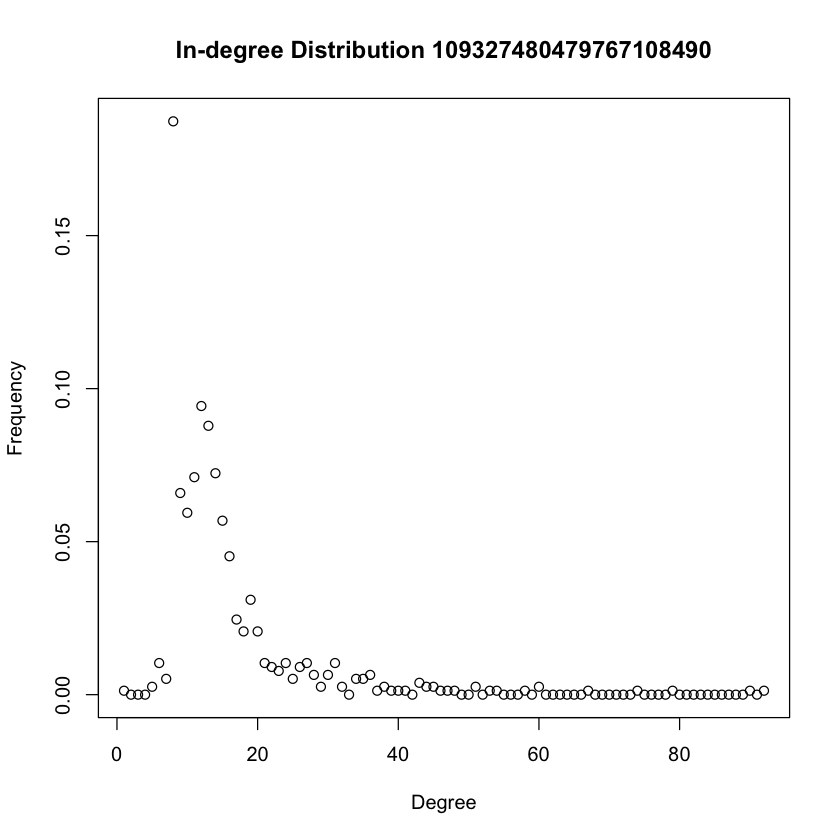

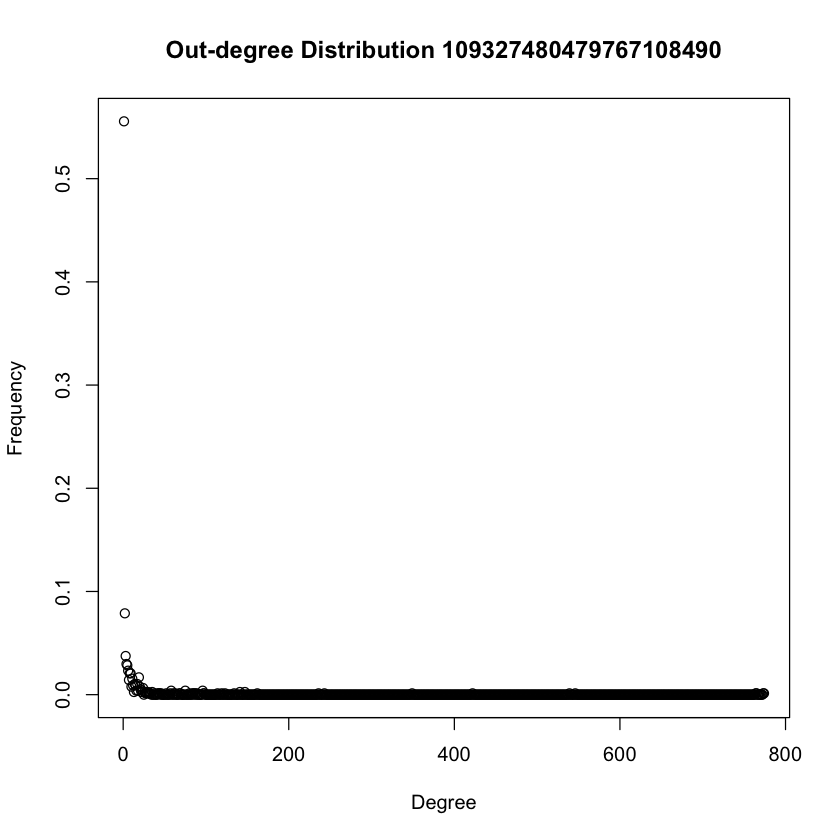

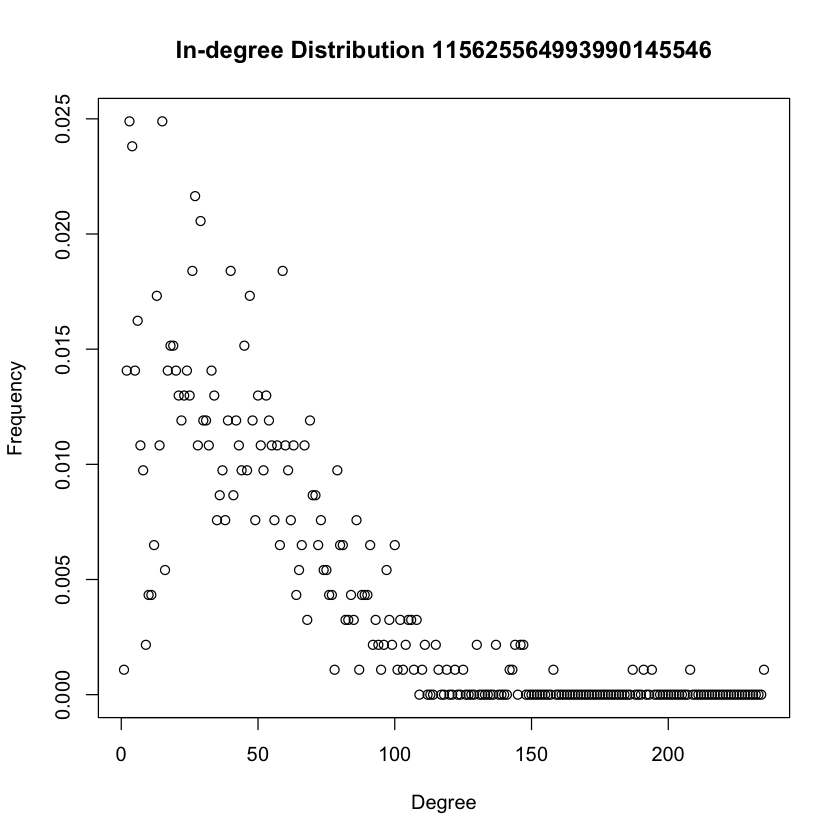

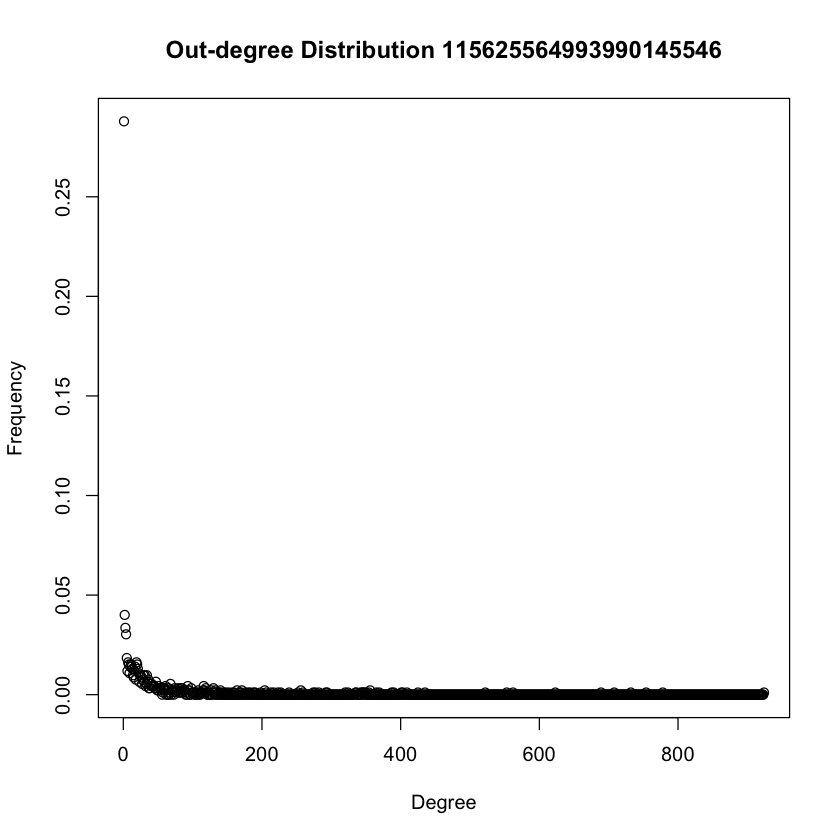

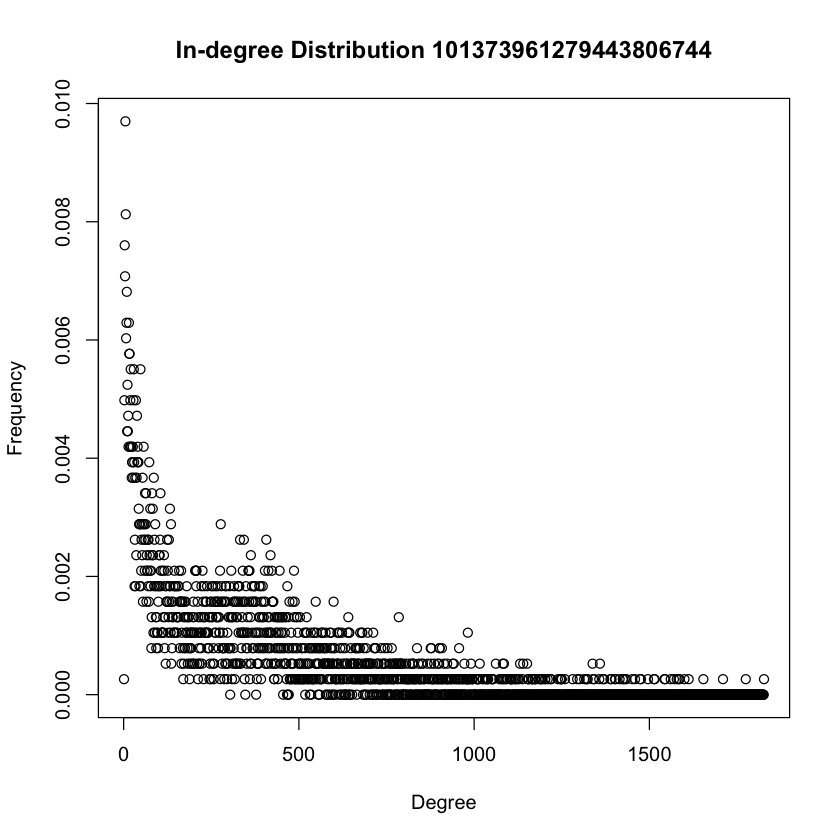

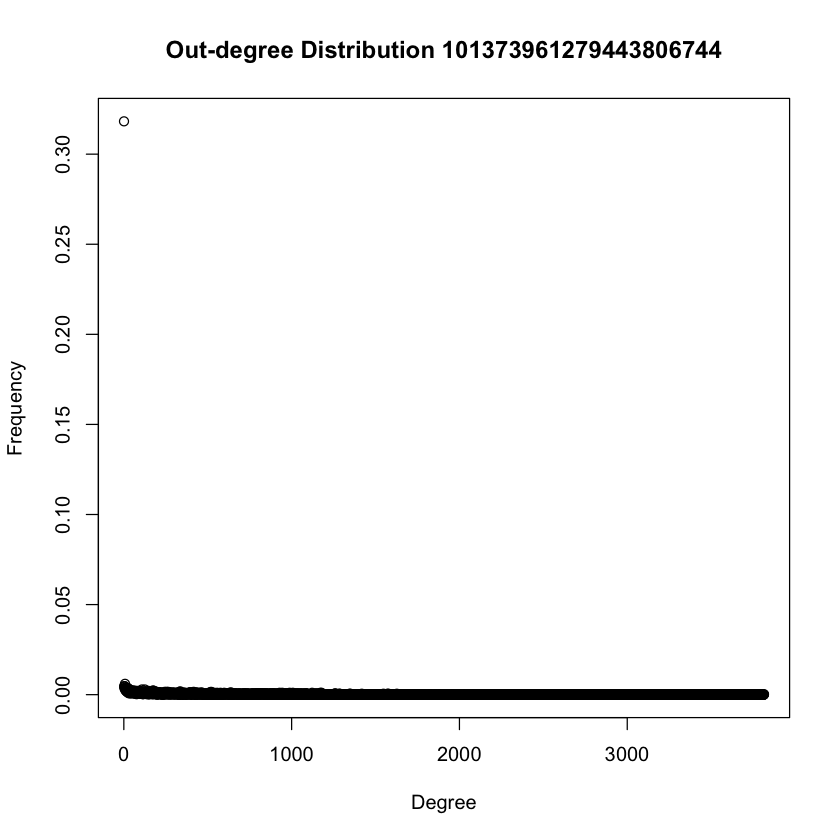

In [0]:
for (n in nodes) {
    g <- getPersonalNetwork(n)
    plot(degree.distribution(g , mode="in"), 
         main=paste("In-degree Distribution", n),
         xlab="Degree", ylab="Frequency")
    plot(degree.distribution(g , mode="out"), 
         main=paste("Out-degree Distribution", n),
         xlab="Degree", ylab="Frequency")
}

### Q20

[1] "Node 109327480479767108490 Modularity = 0.252765387296677"


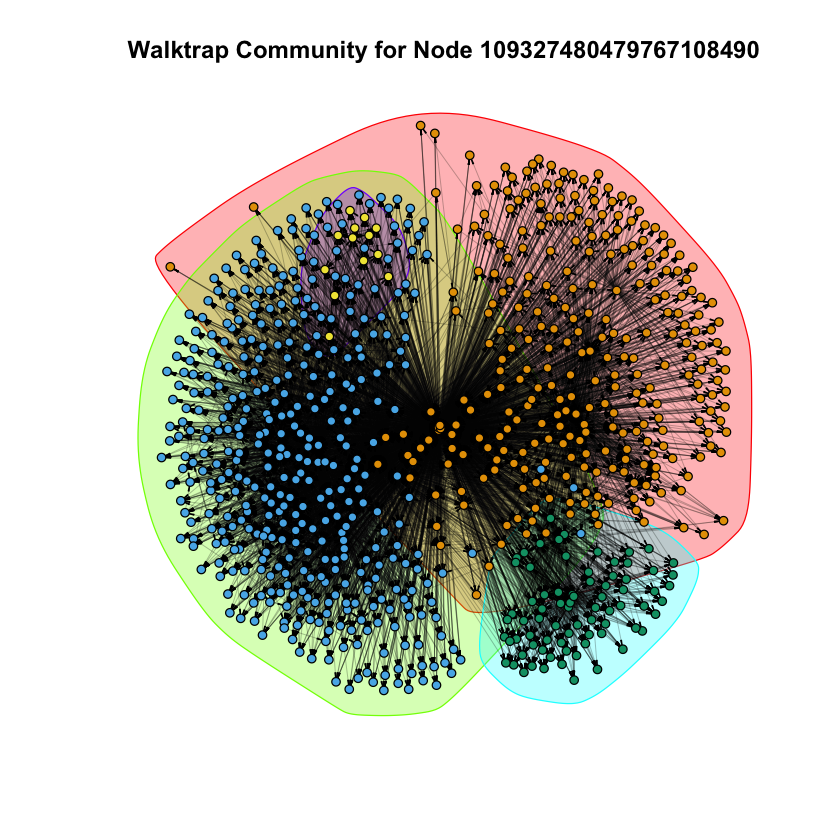

[1] "Node 115625564993990145546 Modularity = 0.319472551345825"


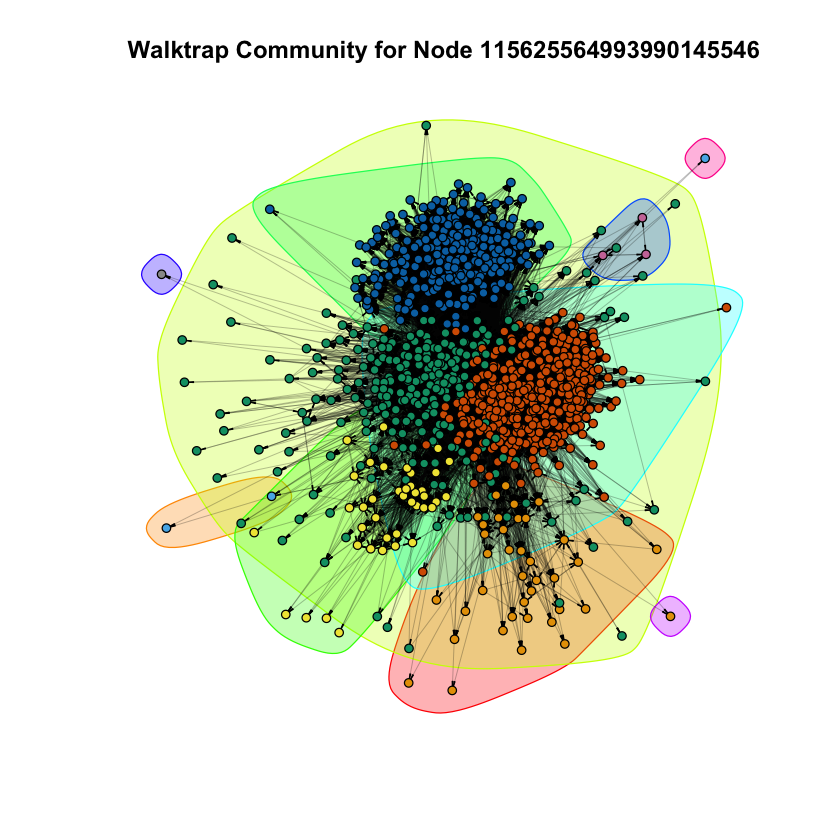

[1] "Node 101373961279443806744 Modularity = 0.191090270876884"


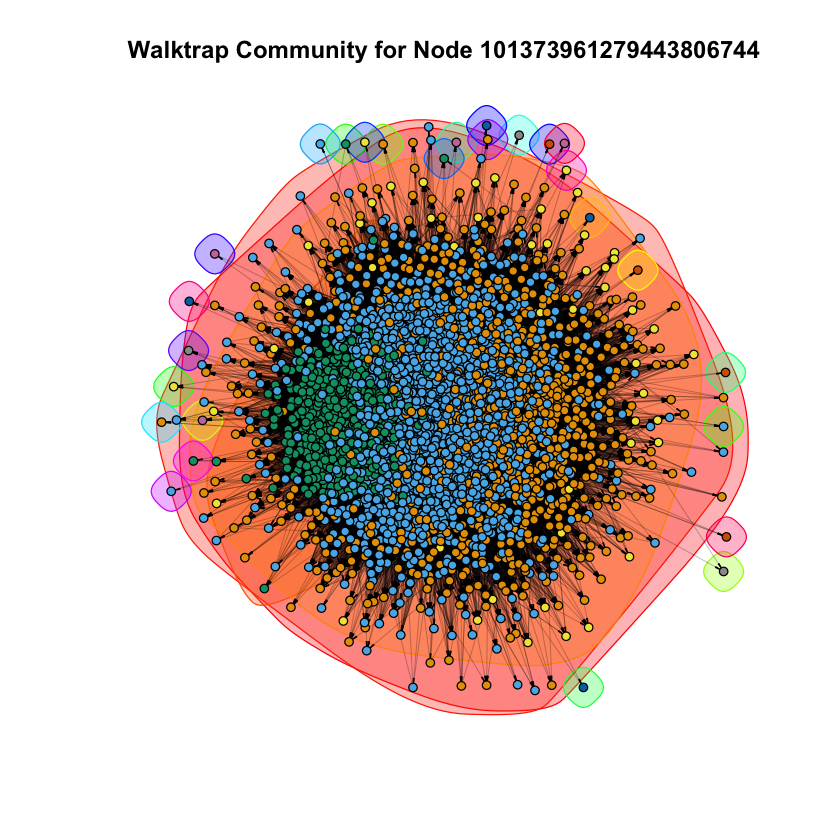

In [0]:
for (n in nodes) {
    g <- getPersonalNetwork(n)
    g.community <- walktrap.community(g)
    plot(g.community, g, 
         vertex.label = NA, 
         vertex.size = 3, 
         edge.color = 'black', 
         edge.width = 0.2, 
         edge.arrow.size = 0.2, 
         edge.arrow.width = 0.2,
         main = paste("Walktrap Community for Node", n))
    m <- modularity(g.community)
    print(paste("Node", n, "Modularity =", m))
}

### Q21-22

In [0]:
computeScores <- function(nodeID) {
    
    filePath <- paste0(dataDir, nodeID, ".circles")
    fileData <- readLines(file(filePath, open = "r"))
    
    g <- getPersonalNetwork(nodeID)
    g.community <- walktrap.community(g)
    
    C <- c()    # the set of circles
    K <- c()    # the set of communities
    a <- c()
    b <- c()
    
    for (circle in strsplit(fileData, '\t')) {
        C <- c(C, list(circle[-1]))
        a <- c(a, length(circle[-1]))
    }
    
    for (community in communities(g.community)) {
        K <- c(K, list(community))
        b <- c(b, length(intersect(community, unique(unlist(C)))))
    }

    A = matrix(0, length(K), length(C))
    for(j in 1:length(K)) {
        for(i in 1:length(C)) {
             A[j, i] <- length(intersect(unlist(K[j]), unlist(C[i])))
        }
    }

    N <- length(unique(unlist(C)))
    
    H.C <- -sum(sapply(a/N, function(n) if(n>0) n*log(n) else 0))
    H.K <- -sum(sapply(b/N, function(n) if(n>0) n*log(n) else 0))
    
    H.C_K <- 0
    H.K_C <- 0
    
    for(j in 1:length(K)) {
        for(i in 1:length(C)) {
            if(A[j, i] > 0) {
                H.C_K <- H.C_K - A[j, i]/N * log(A[j, i]/b[j])
            }
        }
    }
    
    for(i in 1:length(C)) {
        for(j in 1:length(K)) {
            if(A[j, i] > 0) {
                H.K_C <- H.K_C - A[j, i]/N * log(A[j, i]/a[i])
            }
        }
    }
                       
    h <- 1 - H.C_K / H.C
    c <- 1 - H.K_C / H.K
                       
    return(c(h, c))
}

In [0]:
for (n in nodes) {
    s <- computeScores(n)
    print(paste("Node", n, ": h =", s[1], ", c =", s[2]))
}

[1] "Node 109327480479767108490 : h = 0.851885115440867 , c = 0.329873913536689"
[1] "Node 115625564993990145546 : h = 0.451890303032235 , c = -3.4239623491117"
[1] "Node 101373961279443806744 : h = 0.0038667069813052 , c = -1.5042383879479"
